# **Credit Score Classification - Machine Learning project**

## **Librerías**

In [1]:
# Basics
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Split y escalado
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# Modelos clasificación
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.experimental import enable_halving_search_cv  
from sklearn.model_selection import HalvingGridSearchCV
from xgboost import XGBClassifier
from sklearn.model_selection import RandomizedSearchCV, StratifiedKFold
from imblearn.pipeline import Pipeline as IMBPipeline

                                 
# Herramientas de selección de modelos y evaluación
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.model_selection import GridSearchCV, cross_val_predict
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from sklearn.metrics import classification_report, confusion_matrix

# Para manejar desequilibrios en las clases del target --> creación de datos artificiales para balanceo
from imblearn.over_sampling import SMOTE

# Configuración de visualización
%matplotlib inline
sns.set(style="whitegrid")

import sys
sys.path.append('..')  
from scripts import utilities as fs


In [2]:
import importlib
importlib.reload(fs)

<module 'scripts.utilities' from '/Users/jaimeinchaurraga/Documents/GitHub/02_ML_Project_Credit_Score_Classification/notebooks/../scripts/utilities.py'>

## ÍNDICE



1. **Problema de negocio y enfoque técnico**

2. **Carga de datos y pre-análisis**  
    2.1 Comprobaciones básicas: número de entradas y columnas, tipos de datos, etc.  
    2.2 Descripción de datos numéricos  
    2.3 Distribución del target  
    2.4 Reporte de valores faltantes y cardinalidad  
    2.5 Descripción de variables  
    2.6 Observaciones generales  

3. **Reducción preliminar**  
    3.1 Eliminación de características no útiles  
    3.2 Eliminación de filas duplicadas  


4. **Procesamiento y análisis de datos**  
    4.1 Forzar el tipo de datos (data type)  
    4.2 Características numéricas: Reporte de estructura y cambios a realizar  
    4.3 Características numéricas: Procesado y limpieza  
    4.4 Análisis variables numéricas      
    4.5 Características categóricas: Reporte de estructura y cambios a realizar  
    4.6 Características categóricas: Procesado y limpieza   
    4.7 Análisis variables categóricas   


5. **Feature Engineering**  
    5.1 Encoding variables categóricas  
    5.2 Split de datos  
    5.3 Feature importance mediante modelado   
    5.4 Reducción de features  
    5.5 Escalado 


6. **Modelos**  
    6.1 Elección de modelos   
    6.2 Linear Regression  
    6.3 Naive Bayes  
    6.4 XGBoostClassifier Classifier  
    6.5 Gradient Boosting Classifier  
    6.6 Random Forest Classifier  
    6.7 Análisis y conclusiones  


7. **Conclusiones finales**  

## **1 - Problema de negocio y aproach técnico**


Mediante la información financiera de una persona, un banco es capaz de realizar un credit scoring y de esa manera clasificar a sus clientes con diferentes puntuajes para determinar si son aptos para un préstamo o no.  

- **El problema está en que actualmente este proceso está siendo realizando a través de métodos manuales en el que se destinan muchos recursos.**  

- **El objetivo es el de automatizar este proceso para aumentar la eficiencia y reducir los costes de la entidad bancaria.**    

- **Para abordar el problema de negocio, se llevará a cabo un estudio y procesado de los datos para posteriomente aplicar una serie de modelos supervisados multiclase para finalmente seleccionar aquel que obtenga mejor rendimiento.**


## **2 - Carga de datos y pre-análisis**

### **2.1 Comprobaciones básicas: número de entradas y columnas, tipos de datos, etc.**

In [3]:
train_df = pd.read_csv('../data/train.csv', low_memory=False)
test_df = pd.read_csv('../data/test.csv',  low_memory=False)
pd.set_option('display.max_columns', None)
train_df.sample(5)

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
98996,0x25a0e,CUS_0x531a,May,Nathanz,38,819-33-4443,Journalist,32812.59,2782.382500,6,6,5,3,"Auto Loan, Debt Consolidation Loan, and Home E...",10,11,4.82,1.0,_,437.84,39.205356,28 Years and 2 Months,No,54.637566,211.78908762061963,Low_spent_Small_value_payments,301.8115965441356,Standard
59689,0x173bf,CUS_0x22f7,February,Nick Brownm,41,428-63-8269,Mechanic,10542.045,1082.503750,7,6,19,4_,"Not Specified, Home Equity Loan, Debt Consolid...",5,10,5.54,0.0,Standard,528.87,23.842093,17 Years and 3 Months,No,25.948712,68.35654768351827,Low_spent_Small_value_payments,303.94511493679835,Standard
81588,0x1f40e,CUS_0xacf7,May,Viswanathay,51,918-95-7408,Mechanic,142544.36_,NaN,0,4,3,0,NaN,2,4,4.45,1.0,Good,855.55,30.085064,NaN,No,726.088356,626.5032815576435,Low_spent_Medium_value_payments,862.1663851090228,Standard
72933,0x1c157,CUS_0x56f6,June,Davidw,54,763-69-8653,Scientist,22205.61,2037.467500,6,5,11,3,"Home Equity Loan, Mortgage Loan, and Payday Loan",2,8,14.1,3.0,_,207.04,31.552809,26 Years and 4 Months,No,46.079099,69.69684878928496,Low_spent_Small_value_payments,377.9708026420765,Poor
53497,0x14f77,CUS_0x3fb4,February,Sassarda,32,444-48-5334,Mechanic,73871.32,5985.943333,5,7,10,0,NaN,15,NaN,4.01,4.0,Standard,217.57,36.293211,15 Years and 2 Months,No,0.000000,117.88399903752949,High_spent_Large_value_payments,720.7103342958038,Standard


In [3]:
train_df.info()
pd.set_option('display.max_columns', None)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Month                     100000 non-null  object 
 3   Name                      90015 non-null   object 
 4   Age                       100000 non-null  object 
 5   SSN                       100000 non-null  object 
 6   Occupation                100000 non-null  object 
 7   Annual_Income             100000 non-null  object 
 8   Monthly_Inhand_Salary     84998 non-null   float64
 9   Num_Bank_Accounts         100000 non-null  int64  
 10  Num_Credit_Card           100000 non-null  int64  
 11  Interest_Rate             100000 non-null  int64  
 12  Num_of_Loan               100000 non-null  object 
 13  Type_of_Loan              88592 non-null   ob

### **2.2 Descripción de datos numéricos**

In [9]:
train_df.describe()

,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Delay_from_due_date,Num_Credit_Inquiries,Credit_Utilization_Ratio,Total_EMI_per_month
count,84998.000000,100000.000000,100000.00000,100000.000000,100000.000000,98035.000000,100000.000000,100000.000000
mean,4194.170850,17.091280,22.47443,72.466040,21.068780,27.754251,32.285173,1403.118217
std,3183.686167,117.404834,129.05741,466.422621,14.860104,193.177339,5.116875,8306.041270
min,303.645417,-1.000000,0.00000,1.000000,-5.000000,0.000000,20.000000,0.000000
25%,1625.568229,3.000000,4.00000,8.000000,10.000000,3.000000,28.052567,30.306660
50%,3093.745000,6.000000,5.00000,13.000000,18.000000,6.000000,32.305784,69.249473
75%,5957.448333,7.000000,7.00000,20.000000,28.000000,9.000000,36.496663,161.224249
max,15204.633333,1798.000000,1499.00000,5797.000000,67.000000,2597.000000,50.000000,82331.000000


Comentarios:

- Variables con datos faltantes
- Valores muy extremos al fijarme en el std y comparla con la media --> no quiero que le sienten mal al modelo 
- Datos que me parecen muy extraños:
    - Num_Bank_Accounts: Una media de 17 cuentas por cliente (WTF?) --> el valor máximo es de 1798; debe tratarse de un error, lo investigaré en detalle. El valor mínimo es negativo
    - Num_Credit_Card: Una media de 22 tarjetas --> un valor máximo de 1499 ---> mismo problema que a priori indica un error
    - Interest_Rate: std altísima y un valor máximo que no tiene sentido
    - Delay_from_due_date: valores mínimos negativos

### **2.3 Distribución del target**

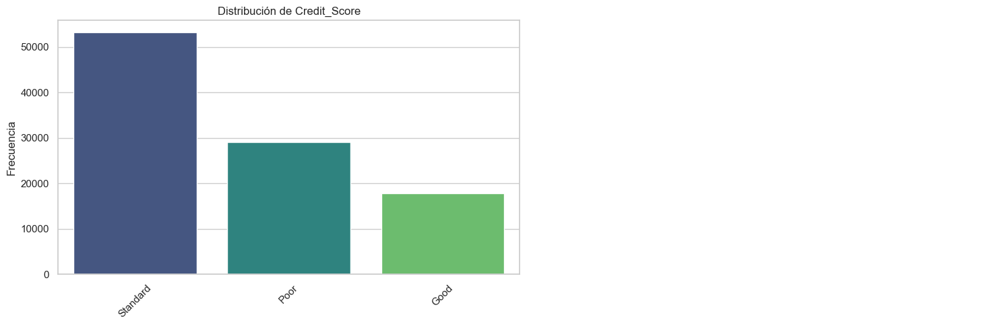

In [6]:
# Echo un vistazo a la distribución del target --> parece algo desbalanceado, lo tendré en cuenta y en su momento decidiré su tratamiento
fs.pinta_distribucion_categoricas(train_df, ["Credit_Score"], relativa=False, mostrar_valores=False)



**OJO!!** Target desbalanceado --> tener en cuenta para el procesamiento futuro


### **2.4 Reporte de valores faltantes y cardinalidad**

In [ ]:
fs.data_report(train_df)

COL_N,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
DATA_TYPE,object,object,object,object,float64,int64,int64,int64,object,object,int64,object,object,float64,object,object,float64,object,object,float64,object,object,object,object
MISSINGS (%),0.0,0.0,0.0,0.0,15.0,0.0,0.0,0.0,0.0,11.41,0.0,7.0,0.0,1.96,0.0,0.0,0.0,9.03,0.0,0.0,4.48,0.0,1.2,0.0
UNIQUE_VALUES,8,1788,16,18940,13235,943,1179,1750,434,6260,73,749,4384,1223,4,13178,100000,404,3,14950,91049,7,98792,3
CARDIN (%),0.01,1.79,0.02,18.94,13.24,0.94,1.18,1.75,0.43,6.26,0.07,0.75,4.38,1.22,0.0,13.18,100.0,0.4,0.0,14.95,91.05,0.01,98.79,0.0



- DATA_TYPE: hay que cambiar el dtype a numéricas de la mayoría de variables  
- MISSINGS (%): ninguna variable tiene más de 15% de valores nulos por lo que no se eliminará ninguna columna; se realizarán sus imputaciones en su momento  
- CARDIN (%): 'Credit_Utilization_Ratio','Amount_invested_monthly' y 'Monthly_Balance'  tienen una cardinalidad del 100% o parecida --> análsis profundo para detectar el problema y ver qué hacer con ellas. En principio no me gustaría eliminarlas ya que parecen mostrar info
muy relevante --> en todo caso tratarlas a través de rangos 


### **2.5 Descripción de variables**


| Nombre de Variable         | Descripción                                  | Tipo de Variable | Importancia | Comentarios |
|----------------------------|----------------------------------------------|------------------|-------------|-------------|
| Customer_ID                | Identificador único por cliente.             | object           | 1           |  No interesa           |
| Month                      | Mes del registro.                            | object           | 2           | No interesa            |
| Name                       | Nombre del cliente.                          | object           | 1           |  No interesa           |
| Age                        | Edad en años.                                | object           | 4           |             |
| SSN                        | Número de Seguridad Social.                  | object           | 1           | No interesa            |
| Occupation                 | Profesión.                                   | object           | 5           |             |
| Annual_Income              | Ingresos anuales.                            | object           | 5           |             |
| Monthly_Inhand_Salary      | Sueldo neto mensual.                         | float64          | 5           |             |
| Num_Bank_Accounts          | Número de cuentas bancarias.                 | int64            | 3           |             |
| Num_Credit_Card            | Número de tarjetas de crédito.               | int64            | 4           |             |
| Interest_Rate              | Tasa de interés de préstamos.                | int64            | 3           |             |
| Num_of_Loan                | Número de préstamos adquiridos.              | object           | 4           |             |
| Type_of_Loan               | Tipos de préstamo.                           | object           | 4           |             |
| Delay_from_due_date        | Días de atraso promedio en pagos.            | int64            | 3           |             |
| Num_of_Delayed_Payment     | Promedio de pagos atrasados.                 | object           | 3           |             |
| Changed_Credit_Limit       | Porcentaje de cambio en límite de crédito.   | object           | 3           |             |
| Num_Credit_Inquiries       | Número de consultas de crédito.              | float64          | 2           |             |
| Credit_Mix                 | Clasificación del crédito (Bad, Standard, Good). | object      | 4           |  Para muy similar al target. Analizar           |
| Outstanding_Debt           | Deuda total pendiente.                       | object           | 4           |             |
| Credit_Utilization_Ratio   | Ratio de utilización de crédito.             | float64          | 5           |             |
| Credit_History_Age         | Antigüedad de la historia de crédito.        | object           | 4           |             |
| Payment_of_Min_Amount      | Solo pago del mínimo realizado.              | object           | 3           |             |
| Total_EMI_per_month        | Cuota mensual equivalente (EMI).             | float64          | 5           |             |
| Amount_invested_monthly    | Inversión mensual.                           | object           | 4           |             |
| Payment_Behaviour          | Hábitos de pago.                             | object           | 4           |             |
| Monthly_Balance            | Balance mensual disponible.                  | object           | 5           |             |
| Credit_Score               | Calificación de crédito (Poor, Standard, Good). | object     | 5           |   Target          |


### **2.6 Observaciones generales**

- Nulos a manejar.
- Símbolos extraños a manejar
- Valores negativos --> entender el contexto y tratarlos si es necesario
- Selección de features --> unas cuantas no son interesantes
- DType incorrecto
- Outliers en las variables numéricas --> qué hacer?
- IMPORTANTE --> cuento con 2 ficheros --> tienen las mismas features pero 'test' no tiene target, 
se podría hacer predict con todos esos datos nuevos pero no puedo obtener los resultados --> qué hacer?

## **3 - Reducción preeliminar**

### **3.1 Eliminar columnas de nombres e IDs**

In [4]:
columnas_ids = ['Customer_ID','ID', 'Name', 'SSN']
train_df = train_df.drop(columns=columnas_ids)

### **3.2 Detectar si hay duplicados y eliminarlos**

In [5]:
n_filas_dup = train_df.duplicated().sum()
print(f'filas duplicadas: {n_filas_dup}')

filas duplicadas: 0


### **3.3 Identificación de dtypes incorrectos**

In [5]:
# Agrupar columnas que necesitan cambio de dtype:

# columnas object a convertir a int64
columnas_object_to_int = ['Age', 'Num_of_Loan', 'Num_of_Delayed_Payment'] # RECUERDA: 'Credit_History_Age' la tengo que tratar luego
# columnas float a convertir a int64
columnas_float_to_int = ['Num_Credit_Inquiries']
# columnas object a convertir a float64
columnas_object_to_float = ['Annual_Income', 'Changed_Credit_Limit', 'Outstanding_Debt', 'Amount_invested_monthly', 'Monthly_Balance']

In [6]:
# Para poder trabajar con los NaaNs primero debo incluirlas en una lista y convertirlas todas a float
todas_las_columnas = columnas_object_to_int + columnas_float_to_int + columnas_object_to_float

## 4. **Procesamiento y análisis de datos**

### **4.1 - Cambiar el dtype en las columnas que deberían numéricas**

In [7]:
# A través de una expresión regular, identifico caracteres que no sean números y los quito
def limpiar_y_convertir(columna):
    # Convierte la columna a string y luego utiliza str.extract para extraer solo la parte numérica
    columna_limpia = columna.astype(str).str.extract(r'([-\d.]+)', expand=False)
    # Convierte los valores extraídos a float, permitiendo NaNs para valores no válidos o faltantes
    columna_limpia = pd.to_numeric(columna_limpia, errors='coerce')
    return columna_limpia


for col in todas_las_columnas:
    train_df[col] = limpiar_y_convertir(train_df[col])

print(train_df[todas_las_columnas].describe())


                 Age    Num_of_Loan  Num_of_Delayed_Payment  \
count  100000.000000  100000.000000            92998.000000   
mean      110.649700       3.009960               30.923342   
std       686.244717      62.647879              226.031892   
min      -500.000000    -100.000000               -3.000000   
25%        24.000000       1.000000                9.000000   
50%        33.000000       3.000000               14.000000   
75%        42.000000       5.000000               18.000000   
max      8698.000000    1496.000000             4397.000000   

       Num_Credit_Inquiries  Annual_Income  Changed_Credit_Limit  \
count          98035.000000   1.000000e+05          97909.000000   
mean              27.754251   1.764157e+05             10.389025   
std              193.177339   1.429618e+06              6.789496   
min                0.000000   7.005930e+03             -6.490000   
25%                3.000000   1.945750e+04              5.320000   
50%                6.000

In [8]:
# Tratamiento especial para 'Credit_History_Age' que es numérica pero tiene un formato extraño --> ej: '24 Years and 9 Months'
#  1- Extraer los años y los meses utilizando una expresión regular
#  2- Convertir los años a meses multiplicándolos por 12 y sumarlos a los meses extraídos


def convertir_a_meses(s):
    # Extrae años y meses usando una expresión regular
    years_months = s.str.extract(r'(?P<Years>\d+)\s+Years\s+and\s+(?P<Months>\d+)\s+Months')
    # Convierte años y meses a float para manejar NaN
    years_months = years_months.astype(float)
    # Convierte todo a meses (años * 12 + meses) y maneja las filas donde se pueda extraer los años y los meses como NaN
    total_months = years_months['Years'] * 12 + years_months['Months']
    return total_months

# Aplicar la función a la columna Credit_History_Age y sobrescribir la columna existente
train_df['Credit_History_Age'] = convertir_a_meses(train_df['Credit_History_Age'])

# Este cambio mantendrá los NaN para las filas donde la extracción falle y convertirá los años y meses a la cantidad total de meses como float



### **4.2 Características numéricas: Reporte de estructura y cambios a realizar**

In [10]:
pd.set_option('display.float_format', lambda x: '%.2f' % x)
train_df.describe()

,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance
count,100000.00,100000.00,84998.00,100000.00,100000.00,100000.00,100000.00,100000.00,92998.00,97909.00,98035.00,100000.00,100000.00,90970.00,100000.00,95521.00,98800.00
mean,110.65,176415.70,4194.17,17.09,22.47,72.47,3.01,21.07,30.92,10.39,27.75,1426.22,32.29,221.20,1403.12,637.41,-30364372469635625254912.00
std,686.24,1429618.05,3183.69,117.40,129.06,466.42,62.65,14.86,226.03,6.79,193.18,1155.13,5.12,99.74,8306.04,2043.32,3181295008384109317718016.00
min,-500.00,7005.93,303.65,-1.00,0.00,1.00,-100.00,-5.00,-3.00,-6.49,0.00,0.23,20.00,1.00,0.00,0.00,-333333333333333314856026112.00
25%,24.00,19457.50,1625.57,3.00,4.00,8.00,1.00,10.00,9.00,5.32,3.00,566.07,28.05,144.00,30.31,74.53,270.09
50%,33.00,37578.61,3093.75,6.00,5.00,13.00,3.00,18.00,14.00,9.40,6.00,1166.15,32.31,219.00,69.25,135.93,336.72
75%,42.00,72790.92,5957.45,7.00,7.00,20.00,5.00,28.00,18.00,14.87,9.00,1945.96,36.50,302.00,161.22,265.73,470.22
max,8698.00,24198062.00,15204.63,1798.00,1499.00,5797.00,1496.00,67.00,4397.00,36.97,2597.00,4998.07,50.00,404.00,82331.00,10000.00,1602.04


In [12]:
fs.data_report(train_df)

COL_N,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
DATA_TYPE,object,int64,object,float64,float64,int64,int64,int64,int64,object,int64,float64,float64,float64,object,float64,float64,float64,object,float64,float64,object,float64,object
MISSINGS (%),0.00,0.00,0.00,0.00,15.00,0.00,0.00,0.00,0.00,11.41,0.00,7.00,2.09,1.96,0.00,0.00,0.00,9.03,0.00,0.00,4.48,0.00,1.20,0.00
UNIQUE_VALUES,8,1728,16,13487,13235,943,1179,1750,414,6260,73,711,4375,1223,4,12203,100000,404,3,14950,91049,7,98792,3
CARDIN (%),0.01,1.73,0.02,13.49,13.24,0.94,1.18,1.75,0.41,6.26,0.07,0.71,4.38,1.22,0.00,12.20,100.00,0.40,0.00,14.95,91.05,0.01,98.79,0.00


In [13]:
train_df.sample()

,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
12887,August,19,Manager,91117.72,7494.14,8,4,19,0,NaN,22,20.00,11.69,0.00,Standard,1465.86,35.49,242.00,No,0.00,269.07,Low_spent_Medium_value_payments,760.34,Standard


In [9]:
# Guardo las estadisticas numéricas para compararlas y graficarlas tras la limpieza
describe_before = train_df.describe()
describe_before.to_csv('describe_before.csv')

Vuelvo a analizar las estrcturas de datos de las variables numéricas pero esta vez de forma muy detallada. Además de con describe y la función de data_report, me apoyo en histogramas,
para entender a fondo todo aquello en lo que debería trabajar

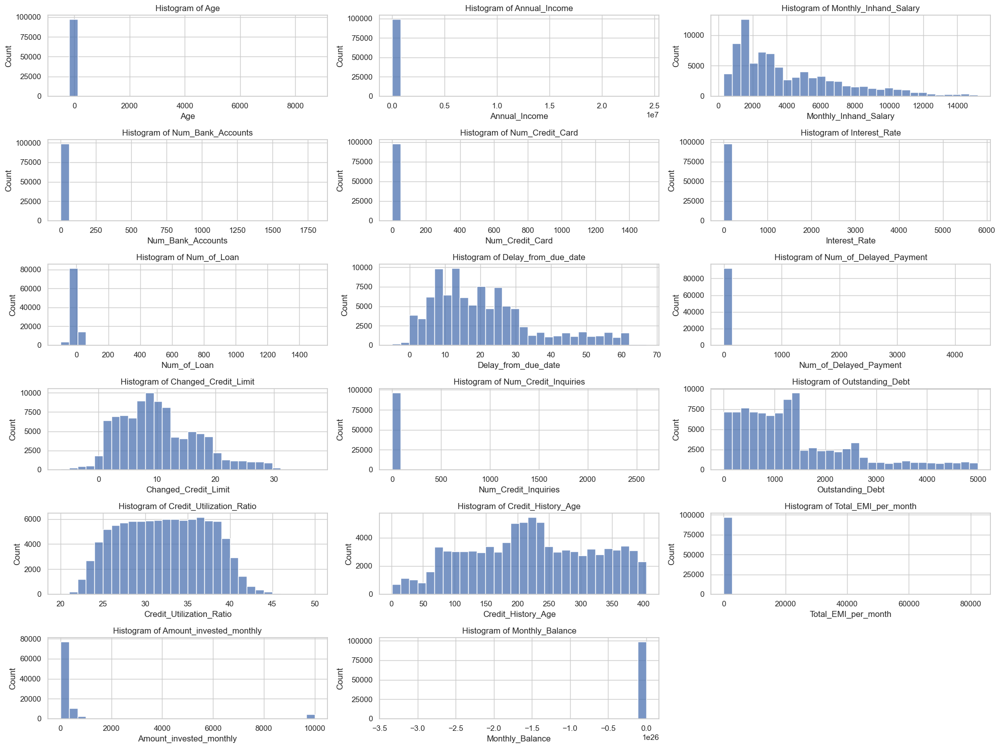

In [14]:
# Histogramas numéricas

# columnas numéricas
num_cols = train_df.select_dtypes(include=['float64', 'int64']).columns

plt.figure(figsize=(20, 15))

for i, col in enumerate(num_cols):
    plt.subplot(len(num_cols) // 3 + 1, 3, i + 1)  
    
    
    sns.histplot(train_df[col], bins=30, kde=False)
    
    plt.xlabel(col)
    plt.title(f'Histogram of {col}')

plt.tight_layout()  
plt.show()  

Tras analizar los datos numéricos:

- Aunque ya he forzado el data type de las columnas para convertirlas en numéricas, en el estado actual no me proporcionan demasiada información relevante.   

- Viendo las variables, existen muchos datos erróneos, outliers y missings, por ello no quiero tratar de analizar en este momento si existen co-relaciones numéricas porque 
la info está demasiado sucia.  

- Muchos de los histogramas muestran una única barra, debido a que la mayoría de los datos están concentrados en un rango estrecho cercano al cero, 
comparado con unos pocos valores extremos que estiran la escala del eje X y hacen difícil apreciar la distribución de la mayoría de los datos.  

- Resulta prefereible hacer un procesamiento de todas las variables numéricas y luego ya realizar los análisis exploratorios correspondientes.



#### Reporte Limpieza de Variables Numéricas

##### Variables a Modificar
- **Age**: Valores mínimos y máximos no realistas. Sustituir valores atípicos por la mediana.
- **Annual_Income**: Presencia de outliers. Requiere evaluación para tratamiento.
- **Monthly_Inhand_Salary**: Contiene valores faltantes y posibles datos extremos. Sustituir missings por mediana.
- **Num_Bank_Accounts**: Valores negativos y extremadamente altos. Sustituir por mediana.
- **Num_Credit_Card**: Valores extremadamente altos. Sustituir por mediana.
- **Interest_Rate**: Valores extremos no realistas. Sustituir por mediana.
- **Num_of_Loan**: Valores negativos y extremos. Sustituir por mediana.
- **Delay_from_due_date**: Valores negativos. Sustituir por mediana.
- **Num_of_Delayed_Payment**: Valores negativos, extremos y presencia de missings. Sustituir por mediana.
- **Changed_Credit_Limit**: Valores negativos y presencia de missings. Sustituir negativos por mediana.
- **Num_Credit_Inquiries**: Valores extremos y missings. Sustituir por mediana.

##### Variables sin Modificaciones Significativas
- **Outstanding_Debt**: Estructura adecuada sin missings ni anomalías.
- **Credit_Utilization_Ratio**: Estructura adecuada. Alta cardinalidad no afecta al ser una variable numérica continua.
- **Credit_History_Age**: Estructura adecuada con un pequeño porcentaje de missings. Imputar missings con mediana.

##### Variables a Modificar - Tratamientos Específicos
- **Total_EMI_per_month**: Identificar y reemplazar outliers utilizando umbral definido por percentil. Sustituir por mediana.
- **Amount_invested_monthly**: Similar a `Total_EMI_per_month`, identificar outliers y missings. Sustituir ambos por mediana.
- **Annual_Income**: Similar a `Total_EMI_per_month`, identificar outliers y missings. Sustituir ambos por mediana.
- **Monthly_Balance**: Presencia de valores negativos extremos y missings. Eliminar filas con valores negativos y sustituir missings por mediana.(muy pocos valores extremos pero con mucho peso)


#### Limpiezas realizadas en variables numéricas

##### Análisis

In [9]:
# En esta celda reside una recopilación de checks que he realizado para posteriomente realizar los tratamiento pertinentes de la siguiente celda
# en general, analizo el número total de valores extremos o incoherentes para a partir de ahí, tomar decisiones de cómo tratarlos

# Age tiene números que no tienen sentido , como negativos y edades muy altas, las cuales debo tratar
valores_negativos = train_df[train_df['Age'] < 0]['Age'].value_counts()
valores_mayores_100 = train_df[train_df['Age'] > 100]['Age'].value_counts()
print(valores_negativos)
# Mostrar las filas con valores negativos en 'Age' --> para ver si tienen algo raro
filas_valores_negativos = train_df[train_df['Age'] < 0]
print(valores_mayores_100)


# Filtra y cuenta cuántos clientes tienen más de 10 cuentas bancarias
num_accounts_mayor_10 = (train_df['Num_Bank_Accounts'] > 10).sum()
print(f"Número de clientes con más de 10 cuentas bancarias: {num_accounts_mayor_10}")
# Filtra y cuenta cuántos clientes tienen un número negativo de cuentas bancarias
num_accounts_menor_0 = (train_df['Num_Bank_Accounts'] < 0).sum()
print(f"Número de clientes con un número negativo de cuentas bancarias: {num_accounts_menor_0}")


# Filtra y cuenta cuántos clientes tienen más de 10 tarjetas
num_credit_card_mayor_10 = (train_df['Num_Credit_Card'] > 10).sum()
print(f"Número de clientes con más de 10 cuentas bancarias: {num_credit_card_mayor_10}")


# Filtra y cuenta cuántos clientes tienen más de 100% de interst rate (más que eso me parece que son datos que no tienen sentido)
num_int_rate_mayor_100 = (train_df['Interest_Rate'] > 100).sum()
print(f"Número de clientes con más de 100% de interés: {num_int_rate_mayor_100}")


# Filtra y cuenta cuántos clientes tienen más de 25 créditos
num_loan_mayor_25 = (train_df['Num_of_Loan'] > 25).sum()
print(f"Número de clientes con más de 25 créditos solicitados: {num_loan_mayor_25}")
# Filtra y cuenta filas que tienen datos negativos 
num_loan_menor_0 = (train_df['Num_of_Loan'] < 0).sum()
print(f"Número de filas con créditos en negativo: {num_loan_menor_0}")


# En este caso no tengo del todo claro que los datos negativos sean 100% incorrectos, aún así voy a aplicar la mediana
# ya que de todas las imputaciones me sigue parecido la más correcta (0 debería ser el menor 'delay' de días que pueda existir a la hora de devolver un préstamo)
# Filtra y cuenta filas que tienen datos negativos en 'Delay_from_due_date'
delay_from_due_date_negativos = (train_df['Delay_from_due_date'] < 0).sum()
print(f"Número de filas con 'Delay_from_due_date' en negativo: {delay_from_due_date_negativos}")


# La variable hace referencia al número de pagos atrasados, por lo que los negativos no tienen sentido
# Filtra y cuenta filas que tienen datos negativos en 'n_delayed_payment'
n_delayed_payment_negativos = (train_df['Num_of_Delayed_Payment'] < 0).sum()
print(f"Número de filas con 'n_delayed_payment' en negativo: {n_delayed_payment_negativos}")
# Filtra y cuenta filas que tienen datos extremos por arriba en 'n_delayed_payment'
n_delayed_payment_extremos = (train_df['Num_of_Delayed_Payment'] > 30).sum()
print(f"Número de filas con 'n_delayed_payment' en extremos por arriba: {n_delayed_payment_extremos}")


# A priori, no tienen mucho sentido los valores negativos en esta variable y un % pequeño de missings, el resto de la estrctura de datos no presenta anomalías
# Filtra y cuenta filas que tienen datos negativos en 'c_credit_limit'
c_credit_limit_negativos = (train_df['Changed_Credit_Limit'] < 0).sum()
print(f"Número de filas con 'Changed_Credit_Limit' en negativo: {c_credit_limit_negativos}")


# Filtra y cuenta filas que tienen más de 15 consultas de crédito, consideradas como valores extremos
n_credit_in = (train_df['Num_Credit_Inquiries'] > 15).sum()
print(f"Número de filas con 'Num_Credit_Inquiries' en valores extremos: {n_credit_in}")


# Definir el umbral como el percentil 97 de 'Total_EMI_per_month'
umbral_extremo = train_df['Total_EMI_per_month'].quantile(0.97) # voy jugando con el percentil y voy viendo los datos que saca, la idea es que no sean muchísimos, los suficientes para que el std no sea muy elevado
# Mostrar el valor específico a partir del cual se considera outlier el dato
print(f"Valor a partir del cual 'Total_EMI_per_month' se considera outlier: {umbral_extremo}")
# Contar el número de filas que tienen valores extremos según el umbral definido
n_extremos = (train_df['Total_EMI_per_month'] > umbral_extremo).sum()
print(f"Número de filas con 'Total_EMI_per_month' en valores extremos: {n_extremos}")


# Definir el umbral como el percentil 97 de 'Amount_invested_monthly'
umbral_extremo_amount_invested = train_df['Amount_invested_monthly'].quantile(0.97)
# Mostrar el valor específico a partir del cual 'Amount_invested_monthly' se considera outlier
print(f"Valor a partir del cual 'Amount_invested_monthly' se considera outlier: {umbral_extremo_amount_invested}")
# Contar el número de filas que tienen valores extremos según el umbral definido
n_extremos_amount_invested = (train_df['Amount_invested_monthly'] > umbral_extremo_amount_invested).sum()
print(f"Número de filas con 'Amount_invested_monthly' en valores extremos: {n_extremos_amount_invested}")


# Los datos negativos son muy muy muy extremos, haciendo que la estructura de datos se desbalncee por completo (mean, std, etc)
# Voy a analizar el número de estos valores y decidir el mejor tratmiento
# Filtra y cuenta filas que tienen valores negativos en 'Monthly_Balance'
monthly_balance_negativos = (train_df['Monthly_Balance'] < 0).sum()
print(f"Número de filas con 'Monthly_Balance' en negativo: {monthly_balance_negativos}")


Age
-500    886
Name: count, dtype: int64
Age
6799    4
4083    3
3920    3
2650    3
5579    3
       ..
7178    1
5621    1
1908    1
4583    1
1342    1
Name: count, Length: 1681, dtype: int64
Número de clientes con más de 10 cuentas bancarias: 1324
Número de clientes con un número negativo de cuentas bancarias: 21
Número de clientes con más de 10 cuentas bancarias: 2307
Número de clientes con más de 100% de interés: 2012
Número de clientes con más de 25 créditos solicitados: 467
Número de filas con créditos en negativo: 3876
Número de filas con 'Delay_from_due_date' en negativo: 591
Número de filas con 'n_delayed_payment' en negativo: 644
Número de filas con 'n_delayed_payment' en extremos por arriba: 736
Número de filas con 'Changed_Credit_Limit' en negativo: 1586
Número de filas con 'Num_Credit_Inquiries' en valores extremos: 2390
Valor a partir del cual 'Total_EMI_per_month' se considera outlier: 4655.149999999994
Número de filas con 'Total_EMI_per_month' en valores extremos: 30

##### Imputaciones

- En esta celda se encuentra el código de todas las imputaciones que se han realizado a partir de el anaálisis previo.  
-  En la mayoría de los casos, se aplica la mediana ya que la media no es representativa debido a los valores extremos.  
- Además, aunque cuente con una gran cantidad de datos, voy a evitar eliminar datos en la medida de lo posible (no quiero deshacerme de muchos pequeños montoncitos que acaben siendo un gran montoncito :)
- En cuanto a los rangos seleccionados, son una mezcla de sentido común y compartivas con las estrcturas de datos que me muestra el describe,  
- El objetivo principal es del hacer un procesado de las variables númericas, haaciendo una pre-transformación centrándome en la eliminación de datos raros, imputación de missings y eliminación de outliers  
que me permitan hacer un buen análisis de correlación y posteriormente una ana´sis más profundo de las variables para determinar su utilidad para el modelo.

In [10]:

# APLICACIÓN DE MEDIANA

# Dejo pendiente el tratamiento de valores extremos, por ahora creo que no son graves
mediana_valida_age = train_df[(train_df['Age'] > 0) & (train_df['Age'] <= 100)]['Age'].median()
train_df.loc[train_df['Age'] <= 0, 'Age'] = mediana_valida_age
train_df.loc[train_df['Age'] > 100, 'Age'] = mediana_valida_age


# Calcular la mediana 
median_salary = train_df['Monthly_Inhand_Salary'].median()
# Imputar valores faltantes con la mediana
train_df['Monthly_Inhand_Salary'].fillna(median_salary, inplace=True)


# Calcular la mediana de Num_Bank_Accounts excluyendo los valores fuera del rango aceptable
mediana_limpia_ba = train_df[(train_df['Num_Bank_Accounts'] >= 0) & (train_df['Num_Bank_Accounts'] <= 10)]['Num_Bank_Accounts'].median()
# Reemplazar valores de Num_Bank_Accounts superiores a 10 o negativos con la mediana calculada
train_df.loc[train_df['Num_Bank_Accounts'] > 10, 'Num_Bank_Accounts'] = mediana_limpia_ba
train_df.loc[train_df['Num_Bank_Accounts'] < 0, 'Num_Bank_Accounts'] = mediana_limpia_ba


# Calcular la mediana de 'Num_Credit_Card' excluyendo los valores fuera del rango aceptable (más de 10)
mediana_limpia_cc = train_df[train_df['Num_Credit_Card'] <= 10]['Num_Credit_Card'].median()
# Reemplazar valores de 'Num_Credit_Card' superiores a 10 con la mediana calculada
train_df.loc[train_df['Num_Credit_Card'] > 10, 'Num_Credit_Card'] = mediana_limpia_cc


# Calcular la mediana de 'Interest_Rate' excluyendo los valores fuera del rango aceptable (más de 100)
mediana_limpia_ii = train_df[train_df['Interest_Rate'] <= 100]['Interest_Rate'].median()
# Reemplazar valores de 'Interest_Rate' superiores a 100 con la mediana calculada
train_df.loc[train_df['Interest_Rate'] > 100, 'Interest_Rate'] = mediana_limpia_ii


# Calcular la mediana de 'Num_of_Loan' excluyendo los valores fuera del rango aceptable (más de 25 o menos de 0)
mediana_limpia_nl = train_df[(train_df['Num_of_Loan'] <= 25) & (train_df['Num_of_Loan'] >= 0)]['Num_of_Loan'].median()
# Reemplazar valores de 'Num_of_Loan' superiores a 25 o inferiores a 0 con la mediana calculada
train_df.loc[(train_df['Num_of_Loan'] > 25) | (train_df['Num_of_Loan'] < 0), 'Num_of_Loan'] = mediana_limpia_nl
# Imputar valores faltantes con la mediana
train_df['Num_of_Loan'].fillna(mediana_limpia_nl, inplace=True)


# Calcular la mediana limpia_de 'Delay_from_due_date' incluyendo solo valores no negativos
mediana_limpia_delay = train_df[train_df['Delay_from_due_date'] >= 0]['Delay_from_due_date'].median()
# Reemplazar valores negativos de 'Delay_from_due_date' con la mediana limpia_calculada
train_df.loc[train_df['Delay_from_due_date'] < 0, 'Delay_from_due_date'] = mediana_limpia_delay
# Imputar valores faltantes con la mediana
train_df['Delay_from_due_date'].fillna(mediana_limpia_delay, inplace=True)


# Calcular la mediana de 'Num_of_Delayed_Payment' excluyendo los valores fuera del rango aceptable (más de 30 o menos de 0)
mediana_limpia_n_delayed = train_df[(train_df['Num_of_Delayed_Payment'] <= 30) & (train_df['Num_of_Delayed_Payment'] >= 0)]['Num_of_Delayed_Payment'].median()
# Reemplazar valores de 'Num_of_Delayed_Payment' superiores a 30 o inferiores a 0 con la mediana calculada
train_df.loc[(train_df['Num_of_Delayed_Payment'] > 30) | (train_df['Num_of_Delayed_Payment'] < 0), 'Num_of_Delayed_Payment'] = mediana_limpia_n_delayed
# Imputar valores faltantes con la mediana
train_df['Num_of_Delayed_Payment'].fillna(mediana_limpia_n_delayed, inplace=True)


# Calcular la mediana limpia_de 'Changed_Credit_Limit' incluyendo solo valores no negativos
mediana_limpia_ch_credit_limit = train_df[train_df['Changed_Credit_Limit'] >= 0]['Changed_Credit_Limit'].median()
# Reemplazar valores negativos de 'Changed_Credit_Limit' con la mediana limpia_calculada
train_df.loc[train_df['Changed_Credit_Limit'] < 0, 'Changed_Credit_Limit'] = mediana_limpia_ch_credit_limit
# Imputar valores faltantes con la mediana
train_df['Changed_Credit_Limit'].fillna(mediana_limpia_ch_credit_limit, inplace=True)


# Calcular la mediana de 'Num_Credit_Inquiries' incluyendo solo valores no superiores a 15
mediana_limpia_n_credit_in = train_df[train_df['Num_Credit_Inquiries'] <= 15]['Num_Credit_Inquiries'].median()
# Reemplazar valores de 'Num_Credit_Inquiries' superiores a 15 con la mediana calculada
train_df.loc[train_df['Num_Credit_Inquiries'] > 15, 'Num_Credit_Inquiries'] = mediana_limpia_n_credit_in
# Imputar valores faltantes con la mediana
train_df['Num_Credit_Inquiries'].fillna(mediana_limpia_n_credit_in, inplace=True)


# Calcular la mediana de 'Credit_History_Age' 
mediana_credit_history_age = train_df['Credit_History_Age'].median()
# Imputar valores faltantes en 'Credit_History_Age' con la mediana calculada
train_df['Credit_History_Age'].fillna(mediana_credit_history_age, inplace=True)



# APlICACIÓN DE QUANTILE
# El uso del quantile a 95 me sirve para establecer un umbral en el cual considero que cualquier valor por encima del mismo es un outlier o un valor extremo
# Esta aplicación la realizo cuando se trata de valores elevados donde no es tan sencillo detectar las anomalías "a ojo" pero el std me indica mucha desviación (tampoco quiero pasarme)


# En este caso, no tengo tan claro qué valores imputar por lo que juego con un umbral de datos y voy viendo los resultados
# Definir el umbral como el percentil 97 de 'Total_EMI_per_month'
umbral_extremo = train_df['Total_EMI_per_month'].quantile(0.95)
# Calcular la mediana de 'Total_EMI_per_month' para los valores no considerados extremos
mediana_limpia_total_emi = train_df[train_df['Total_EMI_per_month'] <= umbral_extremo]['Total_EMI_per_month'].median()
# Reemplazar valores extremos de 'Total_EMI_per_month' con la mediana calculada
train_df.loc[train_df['Total_EMI_per_month'] > umbral_extremo, 'Total_EMI_per_month'] = mediana_limpia_total_emi


# Definir el umbral como el percentil 97 de 'Amount_invested_monthly'
umbral_extremo_amount_invested = train_df['Amount_invested_monthly'].quantile(0.95)
# Calcular la mediana de 'Amount_invested_monthly' para los valores no considerados extremos
mediana_limpia_amount_invested = train_df[train_df['Amount_invested_monthly'] <= umbral_extremo_amount_invested]['Amount_invested_monthly'].median()
# Reemplazar valores extremos de 'Amount_invested_monthly' con la mediana calculada
train_df.loc[train_df['Amount_invested_monthly'] > umbral_extremo_amount_invested, 'Amount_invested_monthly'] = mediana_limpia_amount_invested
# Imputar valores faltantes en 'Amount_invested_monthly' con la misma mediana
train_df['Amount_invested_monthly'].fillna(mediana_limpia_amount_invested, inplace=True)

# Definir el umbral como el percentil 95 de 'Annual_Income'
umbral_extremo_annual_income = train_df['Annual_Income'].quantile(0.95)
# Calcular la mediana de 'Annual_Income' para los valores no considerados extremos
mediana_limpia_annual_income = train_df[train_df['Annual_Income'] <= umbral_extremo_annual_income]['Annual_Income'].median()
# Reemplazar valores extremos de 'Annual_Income' con la mediana calculada
train_df.loc[train_df['Annual_Income'] > umbral_extremo_annual_income, 'Annual_Income'] = mediana_limpia_annual_income
# Imputar valores faltantes en 'Annual_Income' con la misma mediana (si hay valores faltantes)
train_df['Annual_Income'].fillna(mediana_limpia_annual_income, inplace=True)



# ELIMINACIÓN DE FILAS

# Dado que son muy pocos valores los que están causando este problema y debido a que no tenemos un acceso al dominio de negocio para determinar el problema de estos datos , lo mejor es eliminarlos
# IMPORTANTE: elimino las filas también en y_train para mantener la consistencia
# Eliminar filas con 'Monthly_Balance' en negativo
# Identificar índices de las filas con 'Monthly_Balance' en negativo
indices_a_eliminar = train_df[train_df['Monthly_Balance'] < 0].index
# Eliminar esas filas de train_df
train_df = train_df.drop(indices_a_eliminar)
mediana_monthly_balance = train_df['Monthly_Balance'].median()
train_df['Monthly_Balance'].fillna(mediana_monthly_balance, inplace=True)




### **4.4 Análisis variables numéricas**

Como se puede observar, las estructuras ahora son mucho más razonables y regulares, además ya no existen valores erróneos (eje: número de tarjetas en negativo).

Es importante recordar que al no tener una comunicación y dominio del negocio, que muchas de las imputaciones y limpiezas que se han realizado se han hecho a través del sentido común.  
 
Resulta evidente entender que las limpiezas podrían variar dependiendo de las explicaciones de los owners de los datos. Además en este caso, cabe recordar que hay indicios que llevan a pensar que   
los datos pueden haber sido creados de forma artificial (Ej: me cuenta creer que al menos el 50% de 80.000 clientes tengan 5 tarjetas de crédito, o que en un datset bancario existan tantos errores que no tienen sentido   
como números negativos en nº de cuentas bancarias entre otros muchos casos que se pudieron analizar de forma previa al procesamiento)

In [17]:
pd.set_option('display.float_format', lambda x: '%.2f' % x)
train_df.describe()

,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance
count,99991.00,99991.00,99991.00,99991.00,99991.00,99991.00,99991.00,99991.00,99991.00,99991.00,99991.00,99991.00,99991.00,99991.00,99991.00,99991.00,99991.00
mean,33.31,45625.22,4029.06,5.36,5.52,14.52,3.51,21.19,13.47,10.56,5.67,1426.24,32.28,221.00,94.02,183.95,401.76
std,10.63,31698.02,2961.37,2.57,2.04,8.71,2.40,14.75,5.94,6.52,3.68,1155.14,5.12,95.13,89.67,174.24,212.76
min,14.00,7005.93,303.65,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.23,20.00,1.00,0.00,0.00,0.01
25%,25.00,19456.50,1791.85,3.00,4.00,8.00,2.00,10.00,9.00,5.76,3.00,566.05,28.05,154.00,30.31,77.01,270.91
50%,33.00,35662.88,3093.75,5.00,5.00,13.00,3.00,18.00,14.00,9.52,5.00,1166.23,32.31,219.00,64.77,128.33,336.73
75%,41.00,64915.92,5371.53,7.00,7.00,20.00,5.00,28.00,18.00,14.66,8.00,1946.24,36.50,292.00,133.36,216.69,467.68
max,100.00,134533.32,15204.63,10.00,10.00,100.00,23.00,67.00,28.00,36.97,15.00,4998.07,50.00,404.00,437.01,1149.41,1602.04


In [18]:
fs.data_report(train_df)

COL_N,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
DATA_TYPE,object,int64,object,float64,float64,int64,int64,int64,int64,object,int64,float64,float64,float64,object,float64,float64,float64,object,float64,float64,object,float64,object
MISSINGS (%),0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,11.41,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
UNIQUE_VALUES,8,46,16,11983,13235,11,11,53,14,6260,68,29,3716,16,4,12203,99991,404,3,11467,90569,7,98791,3
CARDIN (%),0.01,0.05,0.02,11.98,13.24,0.01,0.01,0.05,0.01,6.26,0.07,0.03,3.72,0.02,0.00,12.20,100.00,0.40,0.00,11.47,90.58,0.01,98.80,0.00


In [14]:
# Guardo las estadisticas numéricas para compararlas y graficarlas tras la limpieza
describe_after = train_df.describe()
describe_after.to_csv('describe_after.csv')

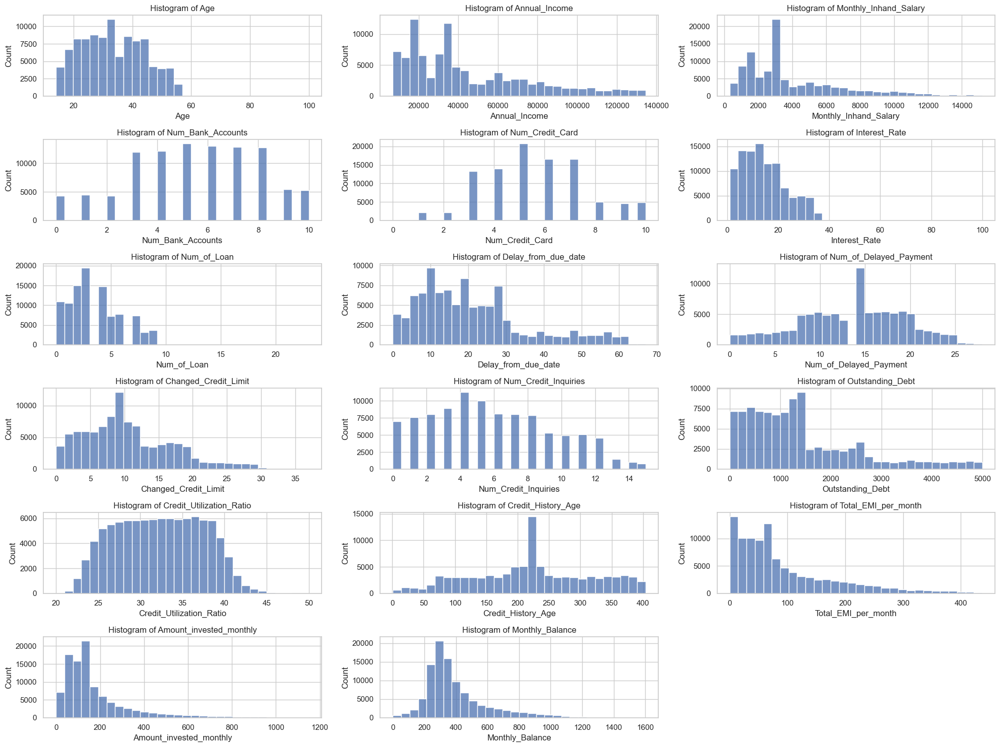

In [20]:
# Utilizar el mismo código para obtener los histogramas de las variables numéricas y comparar las estrcturas de datos antes y depués de el procesamiento

num_cols = train_df.select_dtypes(include=['float64', 'int64']).columns
plt.figure(figsize=(20, 15))

for i, col in enumerate(num_cols):
    plt.subplot(len(num_cols) // 3 + 1, 3, i + 1)
    

    sns.histplot(train_df[col], bins=30, kde=False)
    
    plt.xlabel(col)
    plt.title(f'Histogram of {col}')

plt.tight_layout()  
plt.show() 



- La limpieza de datos ha reducido enormemente de la influencia de outliers y en la normalización de las distribuciones de las variables la imputación de missings 
--> IMPORTANTE: aunque creo que he hecho lo correcto ya que en líneas generales existían datos erróneos y gran cantidad de outliers; creo que esto puede ayudar al modelo 
a funcionar mejor, (especilamente a modelos lineales como regresión logística donde son muy sensibles a los datos extremos) pero me preocupa que al hacer predicts con nuevos datos 
en los que existan outliers este no sepa reponder correctamente.  

- Cada vez cobra más sentido la idea de que los datos son artificales; tras analizar las variables numéricas antes del procesado, se observaban datos incoherentes en la mayoría de columnas;
a diferencia de errores puntuales; existen muchos casos de estos. (Ej: muchos clientes con más de 100 tarjetas de crédito).  

- En un caso idílico, si se tuviera una comunicación con negocio, se podría entender mejor las estructuras y posiblemente los procesados se adaptarían a esa información; aquí voy 'a ciegas'
por lo que aplico lo que considero más coherente. (Ej: me parece que no tiene ningún sentido valores extremos de clientes con más de 10 tarjetas, aplico la mediana donde están agrupados al menos el 50% de los datos donde los usuarios tienen 5 tarjetas)


In [16]:
describe_before.head()

,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance
count,100000.000000,1.000000e+05,84998.000000,100000.000000,100000.00000,100000.000000,100000.000000,100000.000000,92998.000000,97909.000000,98035.000000,100000.000000,100000.000000,90970.000000,100000.000000,95521.000000,9.880000e+04
mean,110.649700,1.764157e+05,4194.170850,17.091280,22.47443,72.466040,3.009960,21.068780,30.923342,10.389025,27.754251,1426.220376,32.285173,221.195405,1403.118217,637.412998,-3.036437e+22
std,686.244717,1.429618e+06,3183.686167,117.404834,129.05741,466.422621,62.647879,14.860104,226.031892,6.789496,193.177339,1155.129026,5.116875,99.741364,8306.041270,2043.319327,3.181295e+24
min,-500.000000,7.005930e+03,303.645417,-1.000000,0.00000,1.000000,-100.000000,-5.000000,-3.000000,-6.490000,0.000000,0.230000,20.000000,1.000000,0.000000,0.000000,-3.333333e+26
25%,24.000000,1.945750e+04,1625.568229,3.000000,4.00000,8.000000,1.000000,10.000000,9.000000,5.320000,3.000000,566.072500,28.052567,144.000000,30.306660,74.534002,2.700922e+02


In [17]:
describe_after.head()

,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance
count,99991.000000,99991.000000,99991.000000,99991.000000,99991.000000,99991.000000,99991.000000,99991.000000,99991.000000,99991.000000,99991.000000,99991.00000,99991.000000,99991.000000,99991.000000,99991.000000,99991.000000
mean,33.314128,45625.220633,4029.063560,5.363633,5.519077,14.515866,3.511426,21.188927,13.468622,10.559244,5.668550,1426.23536,32.284965,220.995250,94.020880,183.948067,401.761347
std,10.628238,31698.017879,2961.368535,2.574857,2.043010,8.712375,2.398859,14.753357,5.943469,6.519921,3.680639,1155.13995,5.116886,95.134246,89.672543,174.238121,212.758697
min,14.000000,7005.930000,303.645417,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.23000,20.000000,1.000000,0.000000,0.000000,0.007760
25%,25.000000,19456.495000,1791.853333,3.000000,4.000000,8.000000,2.000000,10.000000,9.000000,5.760000,3.000000,566.05000,28.052262,154.000000,30.306660,77.010292,270.911984


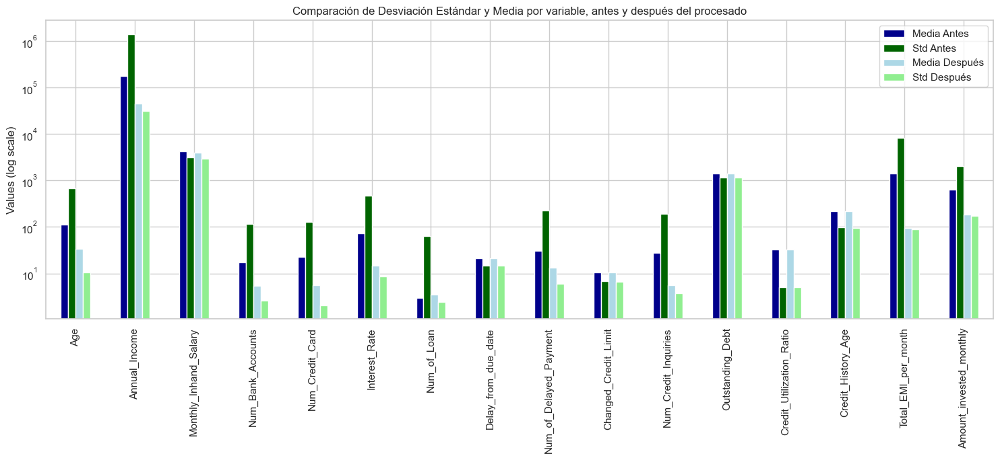

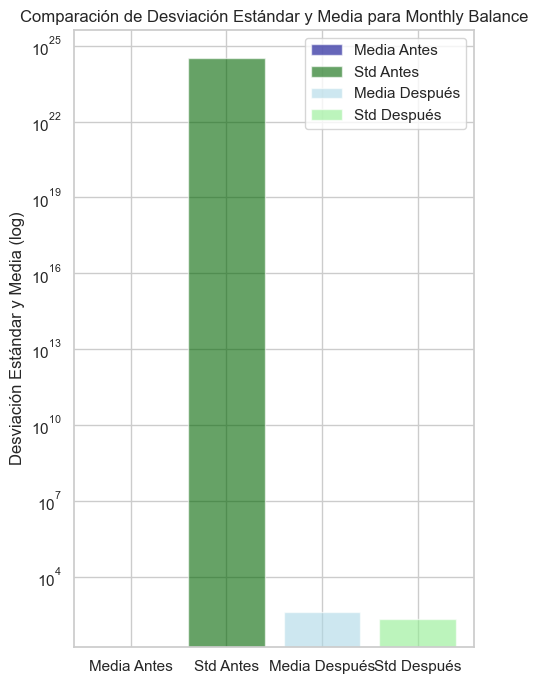

In [30]:


# DFs que contienen los dstos de .describe() antes y depués del procesado
describe_before = pd.read_csv('describe_before.csv', index_col=0)
describe_after = pd.read_csv('describe_after.csv', index_col=0)


std_before = describe_before.loc['std'].drop('Monthly_Balance')
std_after = describe_after.loc['std'].drop('Monthly_Balance')
mean_before = describe_before.loc['mean'].drop('Monthly_Balance')
mean_after = describe_after.loc['mean'].drop('Monthly_Balance')


combined = pd.DataFrame({
    'Media Antes': mean_before,
    'Std Antes': std_before,
    'Media Después': mean_after,
    'Std Después': std_after
})

# colores personalizados
colors = {'Media Antes': 'darkblue', 'Std Antes': 'darkgreen',
          'Media Después': 'lightblue', 'Std Después': 'lightgreen'}

# 
fig, ax = plt.subplots(figsize=(15, 7))
combined.plot(kind='bar', ax=ax, logy=True, color=colors)
plt.ylabel('Values (log scale)')
plt.title('Comparación de Desviación Estándar y Media por variable, antes y después del procesado')
plt.legend()
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

# "Monthly Balance" por separado  ya que al ser tan extremo rompe la gráfica
std_before_mb = describe_before.loc['std', 'Monthly_Balance']
std_after_mb = describe_after.loc['std', 'Monthly_Balance']
mean_before_mb = describe_before.loc['mean', 'Monthly_Balance']
mean_after_mb = describe_after.loc['mean', 'Monthly_Balance']

fig, ax = plt.subplots(figsize=(5, 7))
ax.bar('Media Antes', mean_before_mb, color='darkblue', label='Media Antes', alpha=0.6)
ax.bar('Std Antes', std_before_mb, color='darkgreen', label='Std Antes', alpha=0.6)
ax.bar('Media Después', mean_after_mb, color='lightblue', label='Media Después', alpha=0.6)
ax.bar('Std Después', std_after_mb, color='lightgreen', label='Std Después', alpha=0.6)


plt.yscale('log') # escala logarítmica ya que los valores varían mucho de una feature a otra
plt.ylabel('Desviación Estándar y Media (log)')
plt.title('Comparación de Desviación Estándar y Media para Monthly Balance')
plt.legend()
plt.tight_layout()
plt.show()


Las gráficas  muestran una comparativa del cambio de la estrctura de datos antes y después del procesado

Las métricas utilizadas son la **media** y la **desviación estándar**, ya que ayudan a entender la estrctura de datos, especilamente importante para detectar altos valores de desviación estándar respecto a la media, que pueden ser muy perjudiciales para el modelo.  

El análisis general muestra que, después del procesamiento, tanto la media como la desviación estándar tienden a normalizarse, lo cual sugiere que la limpieza ha sido efectiva en la reducción de valores atípicos y en la corrección de errores, resultando en conjuntos de datos más uniformes.  

En el caso de la variable "Monthly Balance", se observa un cambio drástico, ya que la desviación estándar es muy muy alta debido a un valor negativo anómalamente grande de varios trillones.  
Este valor erróneo rompía por completo la estructura haciendo que la media fuera altamente negativa.

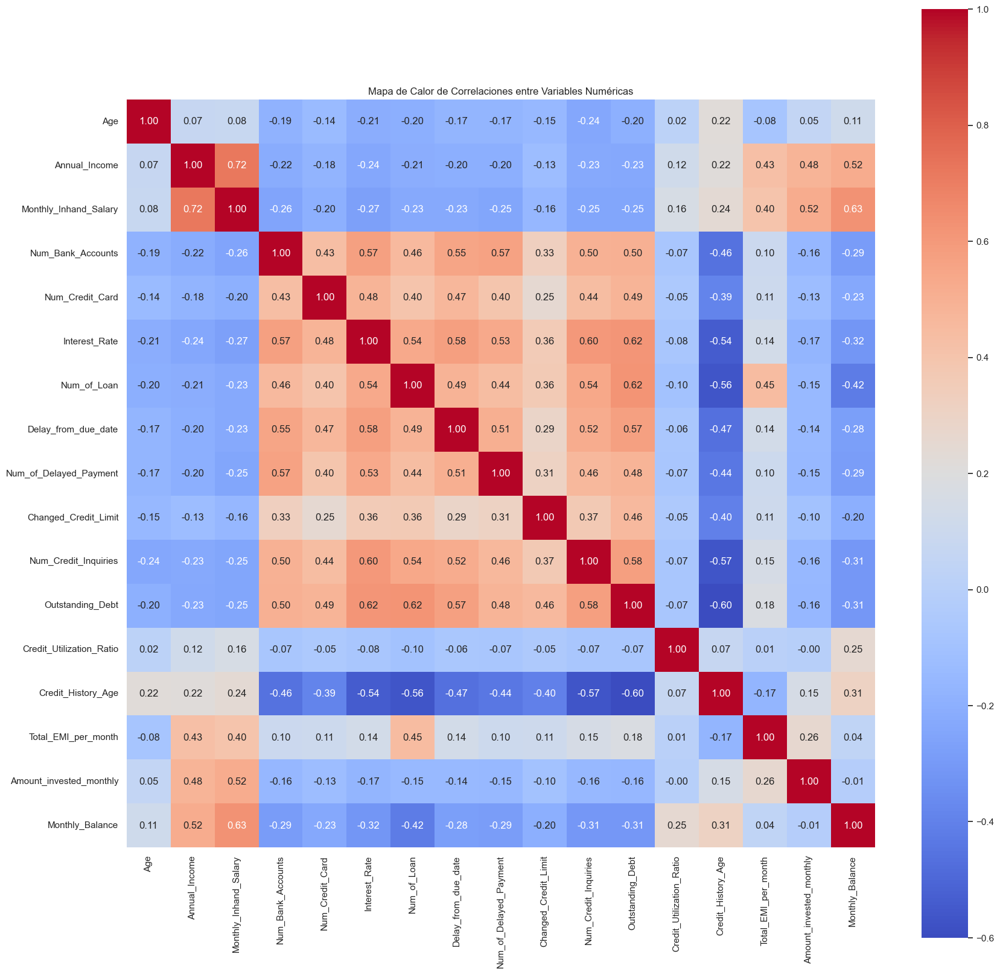

In [21]:
# Correlación entre numéricas mediante pearson
num_X_train = train_df.select_dtypes(include=['float64', 'int64'])

# matriz de correlación a variables numéricas
corr_matrix = num_X_train.corr()

plt.figure(figsize=(20, 20))
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm', cbar=True, square=True)
plt.title('Mapa de Calor de Correlaciones entre Variables Numéricas')
plt.show()


 - Se trata de identificar pares que tengan una alta correlación cercana al 1 o -1 para buscar redundancias y tratar de reducir la dimensionalidad:
 en linéas generales, no existen apenas variables con una fuerte correlación, sólo 'Anual Income' y 'Monthly InHand Salary' tienen más de un 70%.  

 - Correlaciones débiles: hay muchas variables con correlaciones débiles entre ellas, pero puede que tengan relación con el target --> analizar en profundidad.   

 - Dado que la info que se obtiene no es demasiado útil y además es necesario obtener las corelacciones de las variables independientes con la dependiente. Con PEARSON,  
 no es posible por lo que se deben usar otro métodos.  


 Esta función identifica columnas numéricas en un DataFrame y las compara con una columna target de clasificación 
para ver si existe correlación utilizando ANOVA

In [12]:
fs.get_features_num_classification(train_df,'Credit_Score', pvalue=0.05)

['Annual_Income',
 'Monthly_Inhand_Salary',
 'Num_Bank_Accounts',
 'Num_Credit_Card',
 'Num_of_Loan',
 'Delay_from_due_date',
 'Num_of_Delayed_Payment',
 'Changed_Credit_Limit',
 'Num_Credit_Inquiries',
 'Outstanding_Debt',
 'Credit_Utilization_Ratio',
 'Credit_History_Age',
 'Amount_invested_monthly']

In [14]:
# En esta celda hago una comparativa entre todas las columnas numéricas y aquellas que tienen una significancia estadítistica 
# con almenos un 95% de certeza, a través de la función utlizada anteriormente.

todas_las_numericas = train_df.select_dtypes(include=np.number).columns.tolist()

# Lista de columnas numéricas que demostraron tener una significancia estadística

significativas = [
    'Age', 'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
    'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan', 'Delay_from_due_date',
    'Num_of_Delayed_Payment', 'Changed_Credit_Limit', 'Num_Credit_Inquiries',
    'Outstanding_Debt', 'Credit_Utilization_Ratio', 'Credit_History_Age',
    'Total_EMI_per_month', 'Amount_invested_monthly', 'Monthly_Balance'
]

# Identificar las columnas numéricas que no fueron consideradas significativas
no_significativas = [col for col in todas_las_numericas if col not in significativas]

# Imprimir las listas para comparación
print("Todas las columnas numéricas:")
print(todas_las_numericas)
print("\nColumnas numéricas con significancia estadística del 95%:")
print(significativas)
print("\nColumnas numéricas sin significancia estadística (quedaron fuera):")
print(no_significativas)


Todas las columnas numéricas:
['Age', 'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts', 'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan', 'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit', 'Num_Credit_Inquiries', 'Outstanding_Debt', 'Credit_Utilization_Ratio', 'Credit_History_Age', 'Total_EMI_per_month', 'Amount_invested_monthly', 'Monthly_Balance']

Columnas numéricas con significancia estadística del 95%:
['Age', 'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts', 'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan', 'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit', 'Num_Credit_Inquiries', 'Outstanding_Debt', 'Credit_Utilization_Ratio', 'Credit_History_Age', 'Total_EMI_per_month', 'Amount_invested_monthly', 'Monthly_Balance']

Columnas numéricas sin significancia estadística (quedaron fuera):
[]


In [11]:
significant_cols = ['Age','Annual_Income','Monthly_Inhand_Salary','Num_Bank_Accounts','Num_Credit_Card','Interest_Rate','Num_of_Loan','Delay_from_due_date','Num_of_Delayed_Payment',
 'Changed_Credit_Limit','Num_Credit_Inquiries','Outstanding_Debt','Credit_Utilization_Ratio','Credit_History_Age','Total_EMI_per_month','Amount_invested_monthly','Monthly_Balance']

Esta función identifica las variables numéricas que tengan relación significativamente estadística con la variable target y pinta paiplots entre todas ellas.  
Dado que son muchas variables, se muestra mucha información, de primeras puede ser difícil extraer conclusiones de todos los datos, pero sirve para poder ver de un vistazo rápido algún gráfico específico, si posteriormente se necesita, 
se pieden seleccionar sólo las columnas de interés y pintar de nuevo

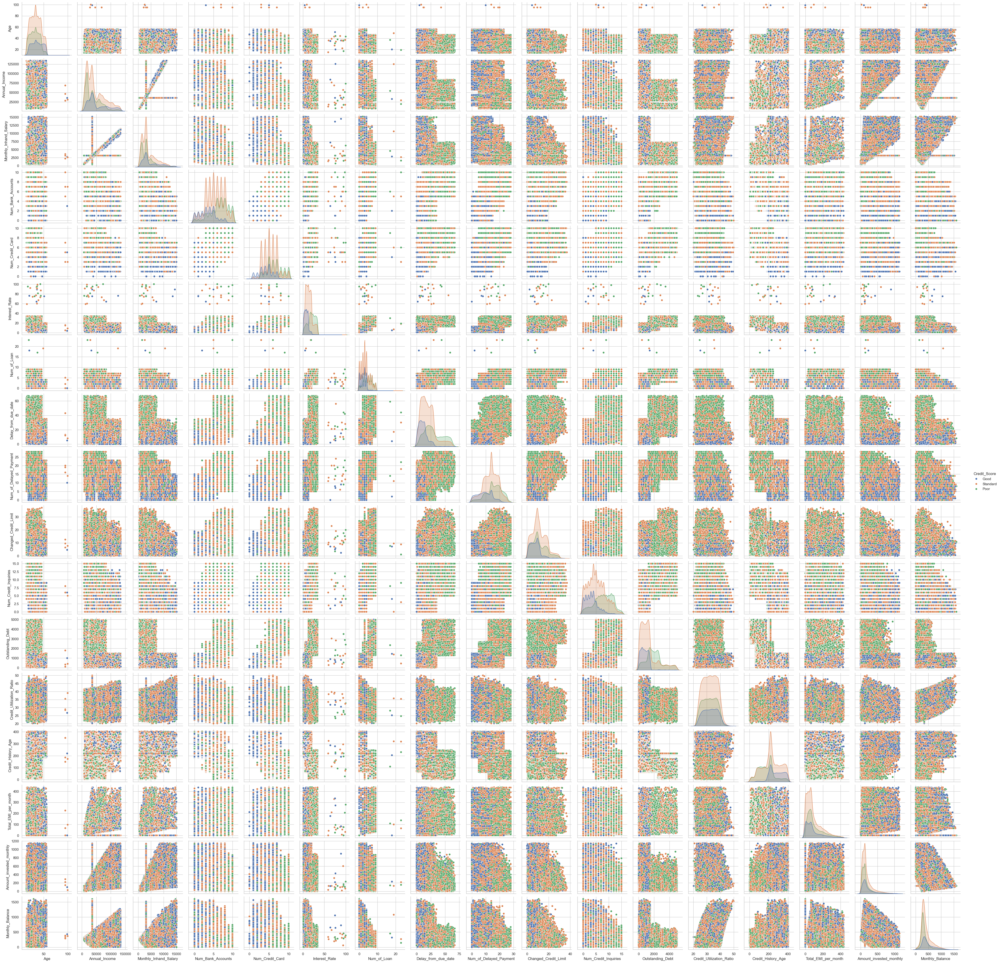

['Age',
 'Annual_Income',
 'Monthly_Inhand_Salary',
 'Num_Bank_Accounts',
 'Num_Credit_Card',
 'Interest_Rate',
 'Num_of_Loan',
 'Delay_from_due_date',
 'Num_of_Delayed_Payment',
 'Changed_Credit_Limit',
 'Num_Credit_Inquiries',
 'Outstanding_Debt',
 'Credit_Utilization_Ratio',
 'Credit_History_Age',
 'Total_EMI_per_month',
 'Amount_invested_monthly',
 'Monthly_Balance']

In [17]:
fs.plot_features_num_classification(train_df, 'Credit_Score', pvalue=0.05)

### **4.5 Features categóricas: Análisis y reporte de cambios a realizar**

In [26]:
# Vuelvo a revisar las características de las columnas, pero esta vez centrándome en las categóricas
fs.data_report(train_df)

COL_N,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
DATA_TYPE,object,int64,object,float64,float64,int64,int64,int64,int64,object,int64,float64,float64,float64,object,float64,float64,float64,object,float64,float64,object,float64,object
MISSINGS (%),0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,11.41,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
UNIQUE_VALUES,8,46,16,11983,13235,11,11,53,14,6260,68,29,3716,16,4,12203,99991,404,3,11467,90569,7,98791,3
CARDIN (%),0.01,0.05,0.02,11.98,13.24,0.01,0.01,0.05,0.01,6.26,0.07,0.03,3.72,0.02,0.00,12.20,100.00,0.40,0.00,11.47,90.58,0.01,98.80,0.00


In [27]:
# Dado que algunas variables tienen muchas categorías, resulta más eficiente sacar un value counts de estas
# para detectar las distribuciones y vr posibles errores o tratamientos a realizar

columnas_categoricas = ['Month','Occupation', 'Type_of_Loan','Credit_Mix','Payment_of_Min_Amount', 'Payment_Behaviour']
for col in columnas_categoricas:
    print(f"Distribución de la columna '{col}':")
    distribucion = train_df[col].value_counts(normalize=True) * 100  # Calcula la frecuencia relativa como porcentaje
    print(distribucion.apply(lambda x: f"{x:.2f}%"))  # Formatea la salida con dos decimales
    print("\n")



Distribución de la columna 'Month':
Month
January     12.50%
May         12.50%
June        12.50%
March       12.50%
April       12.50%
August      12.50%
February    12.50%
July        12.50%
Name: proportion, dtype: object


Distribución de la columna 'Occupation':
Occupation
_______          7.06%
Lawyer           6.57%
Architect        6.36%
Engineer         6.35%
Scientist        6.30%
Mechanic         6.29%
Accountant       6.27%
Developer        6.23%
Media_Manager    6.23%
Teacher          6.22%
Entrepreneur     6.17%
Doctor           6.09%
Journalist       6.08%
Manager          5.97%
Musician         5.91%
Writer           5.89%
Name: proportion, dtype: object


Distribución de la columna 'Type_of_Loan':
Type_of_Loan
Not Specified                                                                                                                                  1.59%
Credit-Builder Loan                                                                                              

#### **Reporte de estructura y cambios a realizar en variable categóricas**


##### Distribución de 'Month':
- Distribución uniforme
- La ausencia de ciertos meses hace que aumenten las sospechas de que los datos son sintéticos


##### Distribución de 'Occupation':
- Distribución uniforme
- Presencia de la categoría "-" a tratar.


#### Distribución de 'Type_of_Loan':
- Alta cardinalidad presente con 6260 categorías únicas
- Aplicar alguna técnica para reducir la dimensionalidad antes de convertirla a numérica
- Alto grado de missings --> decidir mejor tratamiento que no genere sesgos
- Tal vez tenga sentido eliminarla

##### Distribución de 'Credit_Mix':
- Distribución uniforme  
- Variable tiene mismas categorías que la variable target --> investigar
- Presencia de la categoría "_" a tratar.

##### Distribución de 'Payment_of_Min_Amount':
- Más de la mitad de los registros indican que el pago mínimo fue realizado --> algo desbalanceada

##### Distribución de 'Payment_Behaviour':
- Distribución uniforme
- La categoría "!@9#%8" debe ser tratada --> analizar y decidir mejor acción


 ### **4.6 Características categóricas: Procesado y limpieza**

**Imputaciones**

In [11]:
# Imputación de moda en 'Occupation'
# Tras comprobar que el valor "-" resulta ser el más repetido, voy a eliminarlos ya que no quiero añadir la moda del segundo y que esto produzca algún tipo de sesgo

# Elimina directamente las filas donde 'Occupation' es igual a "-" 
indices_eliminar_occupation = train_df[train_df['Occupation'] == '_______'].index
train_df = train_df.drop(indices_eliminar_occupation)


#IMPORTANTE --> voy a realizar el tratamiento en la fase de encoding ya que me está dando problemas
# Agrupar todas las categorías que tienen pocos valores de 'Type_of_Loan' en otra columna para reducir la dimensionalidad y también imputar la moda a los naans
# Limpieza de 'Type_of_Loan'
train_df['Type_of_Loan'] = (
    train_df['Type_of_Loan']
    .str.replace('and', ',')  # Reemplaza 'and' por ',' para uniformidad
    .str.replace(', ', ',')   # Asegura que no haya espacios después de las comas
    .str.strip()              # Elimina espacios en blanco al principio y al final
)
# Imputa los NaN con la moda de 'Type_of_Loan'
moda_type_of_loan = train_df['Type_of_Loan'].mode()[0]
train_df['Type_of_Loan'].fillna(moda_type_of_loan, inplace=True)



# Imputación de moda en 'Credit_Mix' para los valores raros
# Para ello, sustituyo el valor raro por naan y luego les imputo la moda
# Reemplaza '_' por NaN en la columna 'Credit_Mix'
train_df['Credit_Mix'] = train_df['Credit_Mix'].replace('_', np.nan)
moda_credit_mix = train_df['Credit_Mix'].mode()[0]
train_df['Credit_Mix'].fillna(moda_credit_mix, inplace=True)



# Fusión de categorías en 'Payment_of_Min_Amount' debido a que la categoría 'NM' parece un error y dando por sentado que tendría que ser 'No' (yes/no)
train_df['Payment_of_Min_Amount'] = (
    train_df['Payment_of_Min_Amount'].str.replace('NM', 'No').astype("category")
)


# Imputación de moda en 'Payment_Behaviour' para los valores raros
# Para ello, sustituyo el valor raro por naan y luego les imputo la moda
train_df['Payment_Behaviour'] = train_df['Payment_Behaviour'].replace('!@9#%8', np.nan)
moda_Payment_Behaviour = train_df['Payment_Behaviour'].mode()[0]
train_df['Payment_Behaviour'].fillna(moda_Payment_Behaviour, inplace=True)

# Variable target --> tratar naans
# Imputar los valores NaN en 'Credit_Score' con la moda
moda_credit_score = train_df['Credit_Score'].mode()[0]
train_df['Credit_Score'].fillna(moda_credit_score, inplace=True)

In [20]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 92930 entries, 0 to 99999
Data columns (total 24 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   Month                     92930 non-null  object  
 1   Age                       92930 non-null  int64   
 2   Occupation                92930 non-null  object  
 3   Annual_Income             92930 non-null  float64 
 4   Monthly_Inhand_Salary     92930 non-null  float64 
 5   Num_Bank_Accounts         92930 non-null  int64   
 6   Num_Credit_Card           92930 non-null  int64   
 7   Interest_Rate             92930 non-null  int64   
 8   Num_of_Loan               92930 non-null  int64   
 9   Type_of_Loan              92930 non-null  object  
 10  Delay_from_due_date       92930 non-null  int64   
 11  Num_of_Delayed_Payment    92930 non-null  float64 
 12  Changed_Credit_Limit      92930 non-null  float64 
 13  Num_Credit_Inquiries      92930 non-null  float64 


### **4.7 Análisis variables categóricas**

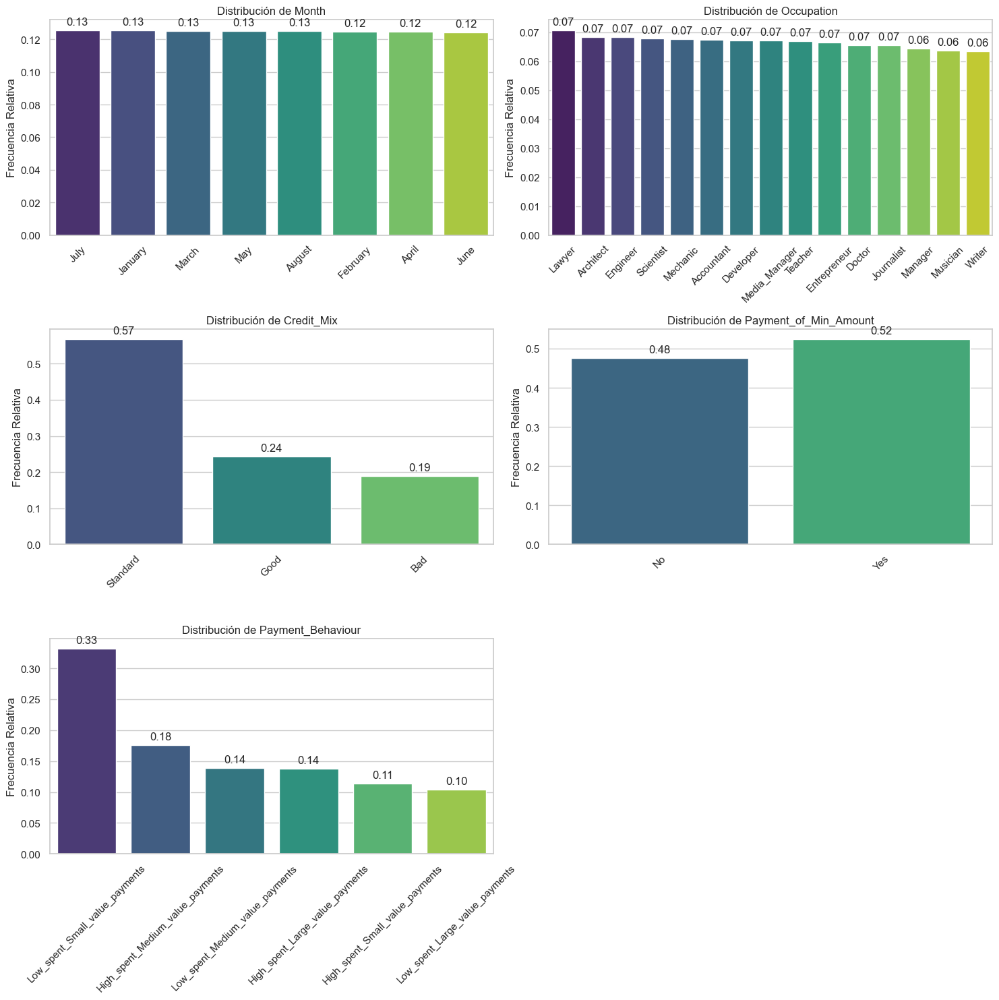

In [12]:
# variables categoricas pero sin 'Type_of_Loan' que aunque se redujo notablemente la dimensionalidad sigue siendo grande
columnas_categoricas_no_loan = ['Month','Occupation','Credit_Mix','Payment_of_Min_Amount', 'Payment_Behaviour']
fs.pinta_distribucion_categoricas(train_df, columnas_categoricas_no_loan, relativa=True, mostrar_valores=True)

Aunque a priori, parece que 'Occupation' y 'Month' pueden ser dos variables no muy útiles debidas a su distrbución muy normal, se van a llevar a cabo una serie de comprobaciones matemáticas que confirmen qué variables categóricas tienen   
relación con la variable target, que también es categórica

**Test Chi-Cuadrado** que es ideal para anallizar si existen relaciones entre variables categóricas e 'y' 

Por cada variable X, se analizará si sus categorías tienden a estar en una categoría específica del target (Standard', 'Good', 'Bad')

In [32]:
from scipy.stats import chi2_contingency

# Lista de variables categóricas para evaluar
columnas_categoricas = ['Month', 'Occupation', 'Type_of_Loan', 'Credit_Mix', 'Payment_of_Min_Amount', 'Payment_Behaviour']
variables_con_relacion_significativa = []

# Nivel de significancia
alpha = 0.05  # Confirmar con un 95% de confianza

# Realiza el test de Chi-Cuadrado para cada variable categórica
for col in columnas_categoricas:
    contingency_table = pd.crosstab(train_df[col], train_df['Credit_Score'])
    chi2, p, dof, expected = chi2_contingency(contingency_table)

    # Verifica si el p-valor es menor que el nivel de significancia
    if p < alpha:
        print(f"La variable {col} tiene una relación significativa con el target 'Credit_Score', p-value: {p}")
        variables_con_relacion_significativa.append(col)
    else:
        print(f"La variable {col} no tiene una relación significativa con el target 'Credit_Score', p-value: {p}")

# Imprime las variables que tienen una relación significativa
print(f"Con un 95% de confianza, se puede demostrar que las siguientes variables tienen relación con el target 'Credit_Score': {variables_con_relacion_significativa}")



La variable Month tiene una relación significativa con el target 'Credit_Score', p-value: 5.1097757848560345e-33
La variable Occupation tiene una relación significativa con el target 'Credit_Score', p-value: 2.8373511823760306e-22
La variable Type_of_Loan tiene una relación significativa con el target 'Credit_Score', p-value: 0.0
La variable Credit_Mix tiene una relación significativa con el target 'Credit_Score', p-value: 0.0
La variable Payment_of_Min_Amount tiene una relación significativa con el target 'Credit_Score', p-value: 0.0
La variable Payment_Behaviour tiene una relación significativa con el target 'Credit_Score', p-value: 1.1049299229733921e-239
Con un 95% de confianza, se puede demostrar que las siguientes variables tienen relación con el target 'Credit_Score': ['Month', 'Occupation', 'Type_of_Loan', 'Credit_Mix', 'Payment_of_Min_Amount', 'Payment_Behaviour']


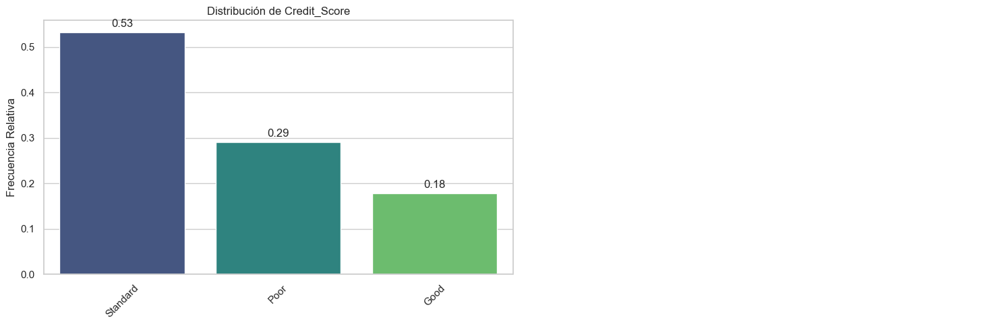

In [34]:
fs.pinta_distribucion_categoricas(train_df, ['Credit_Score'], relativa=True, mostrar_valores=True)

Resulta importante recordar la estructura del target 'Credit_Score'. Tras analizarlo de nuevo y comprobar el desbalance que puede ser muy   
perjudicial para el modelo (*"Si intentamos predecir si una persona va a padecer un cáncer o no, y entrenamos un modelo en el que el 97% de los casos no ha padecido cáncer, si el modelo predice siempre que no tiene cáncer, conseguirá un 97% de precisión"*)

Por ello, en la fase de encoding simplemente voy a realizar un mapeo manual de las tres categorías y cuando se trabaje en el modelo especificaré se añadirán ajustes que pongan más peso en las clases minoritarias.

## **5. Feature Engineering**

### **5.1 Enconding variables categóricas**

In [12]:
# Variables x

# Codificar 'Month' y 'Occupation' usando get_dummies  (no tienen demasidas categorías, por lo que no hace falta que haga reducciones adicionales)
train_df = pd.get_dummies(data=train_df, columns=['Month', 'Occupation'], drop_first=True)

# Mapear 'Credit_Mix' manualmente 
credit_mix_mapping = {'Bad': 0, 'Standard': 1, 'Good': 2}
train_df['Credit_Mix'] = train_df['Credit_Mix'].map(credit_mix_mapping)


# Reemplazar valores en 'Payment_of_Min_Amount' (transformación a 0/1 ya que es binaria)
train_df['Payment_of_Min_Amount'] = train_df['Payment_of_Min_Amount'].replace({'No': 0, 'Yes': 1})

# Codificar 'Payment_Behaviour' usando pd.get_dummies y concatenarlo (no tienen demasidas categorías, por lo que no hace falta que haga reducciones adicionales)
payment_behaviour_dummies = pd.get_dummies(train_df['Payment_Behaviour'], drop_first=True)
train_df = pd.concat([train_df.drop(columns=['Payment_Behaviour']), payment_behaviour_dummies], axis=1)

# Determinar las 10 categorías más comunes de 'Type_of_Loan' (son demasiadas columnas y no quiero tener una alta dimensionalidad)
top_types = train_df['Type_of_Loan'].str.get_dummies(sep=',').sum().sort_values(ascending=False).head(10).index

# Crear variables dummy solo para estas categorías y concatenarlas (sólo me quedo con las 10 primeras)
df_dummies = train_df['Type_of_Loan'].str.get_dummies(sep=',')[top_types]
train_df = pd.concat([train_df.drop(columns=['Type_of_Loan']), df_dummies], axis=1)



In [13]:
# Variable y
# Mapear 'Credit_Score' manualmente
credit_score_mapping = {'Poor': 0, 'Standard': 1, 'Good': 2}
train_df['Credit_Score'] = train_df['Credit_Score'].map(credit_score_mapping)


Se puede observar que la codificación ha sido existosa

In [15]:
train_df.head()

,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Credit_Score,Month_August,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Occupation_Architect,Occupation_Developer,Occupation_Doctor,Occupation_Engineer,Occupation_Entrepreneur,Occupation_Journalist,Occupation_Lawyer,Occupation_Manager,Occupation_Mechanic,Occupation_Media_Manager,Occupation_Musician,Occupation_Scientist,Occupation_Teacher,Occupation_Writer,High_spent_Medium_value_payments,High_spent_Small_value_payments,Low_spent_Large_value_payments,Low_spent_Medium_value_payments,Low_spent_Small_value_payments,Not Specified,Payday Loan,Credit-Builder Loan,Mortgage Loan,Home Equity Loan,Personal Loan,Debt Consolidation Loan,Student Loan,Auto Loan
0,23,19114.12,1824.843333,3,4,3,4,3,7.0,11.27,4.0,1,809.98,26.822620,265.0,0,49.574949,80.415295,312.494089,2.0,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True,False,False,False,0,0,1,0,1,1,0,0,1
1,23,19114.12,3093.745000,3,4,3,4,18,14.0,11.27,4.0,2,809.98,31.944960,219.0,0,49.574949,118.280222,284.629162,2.0,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,0,0,1,0,1,1,0,0,1
2,33,19114.12,3093.745000,3,4,3,4,3,7.0,9.52,4.0,2,809.98,28.609352,267.0,0,49.574949,81.699521,331.209863,2.0,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,True,False,0,0,1,0,1,1,0,0,1
3,23,19114.12,3093.745000,3,4,3,4,5,4.0,6.27,4.0,2,809.98,31.377862,268.0,0,49.574949,199.458074,223.451310,2.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True,0,0,1,0,1,1,0,0,1
4,23,19114.12,1824.843333,3,4,3,4,6,14.0,11.27,4.0,2,809.98,24.797347,269.0,0,49.574949,41.420153,341.489231,2.0,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,0,0,1,0,1,1,0,0,1


In [23]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 92930 entries, 0 to 99999
Data columns (total 55 columns):
 #   Column                            Non-Null Count  Dtype   
---  ------                            --------------  -----   
 0   Age                               92930 non-null  int64   
 1   Annual_Income                     92930 non-null  float64 
 2   Monthly_Inhand_Salary             92930 non-null  float64 
 3   Num_Bank_Accounts                 92930 non-null  int64   
 4   Num_Credit_Card                   92930 non-null  int64   
 5   Interest_Rate                     92930 non-null  int64   
 6   Num_of_Loan                       92930 non-null  int64   
 7   Delay_from_due_date               92930 non-null  int64   
 8   Num_of_Delayed_Payment            92930 non-null  float64 
 9   Changed_Credit_Limit              92930 non-null  float64 
 10  Num_Credit_Inquiries              92930 non-null  float64 
 11  Credit_Mix                        92930 non-null  int64   


### **5.2 Split de datos**

Split de datos en esta fase antes del propio escalado, dado que todos los datos se encuentran procesados y codificados

In [14]:
X = train_df.drop('Credit_Score', axis=1) 
y = train_df['Credit_Score']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


### **5.3 Feature importance mediante modelado**

 Aunque en fases anteriores se llevaro a cabo varios análsis, tanto visuales como matemáticos, no se realizó una reducción de features porque parecían que todas tenían una alta significancia estadística.

 Por ello, se utilizará un modelo Random Forest para realizar un análisis final que trate de puntuar la importancia de las features.
No es necesario realizarlo después del escalado ya que RanndomForest no es sensible a las escalas.

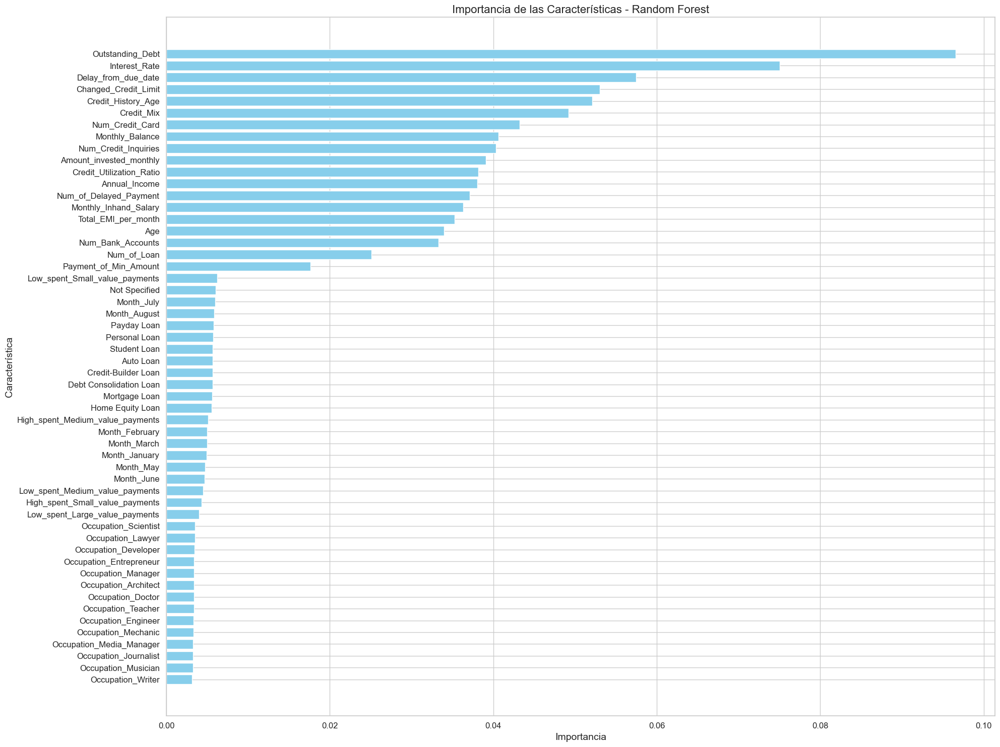

In [14]:

# Inicializar el clasificador Random Forest
rf = RandomForestClassifier(n_estimators=300, random_state=42)

# Entrenar el modelo
rf.fit(X_train, y_train)

# Obtener la importancia de las características
feature_importances = rf.feature_importances_

# DataFrame para facilitar la visualización
features_df = pd.DataFrame({'Feature': X_train.columns, 'Importance': feature_importances})
features_df = features_df.sort_values(by='Importance', ascending=False)

# Visualizar las importancias de las características
plt.figure(figsize=(20, 15))  
plt.barh(features_df['Feature'], features_df['Importance'], color='skyblue')
plt.xlabel('Importancia', fontsize=14)
plt.ylabel('Característica', fontsize=14)
plt.title('Importancia de las Características - Random Forest', fontsize=16)
plt.gca().invert_yaxis()  # Invertir el eje y para que la característica más importante esté arriba
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()  
plt.show()


A través del modelo Random Forest, se genera una gráfica que muestra todas las variables y su puntuaje respecto a la importancia que tienen para el modelo.   
Mediante la construcción de árboles de decisión, se toman preguntas a partir de las características sobre los datos. Algunas de estas son más informativas y ayudan
a predecir el resultado correcto. Es decir, RF mide cuánto ayuda cada característica a reducir la impureza, a mayor reducción de impureza mayor puntuaje.

1 - Se puede apreciar que hay una gran diferencia entre Las deudas pendientes (Outstanding_Debt), la tasa de interés (Interest_Rate), y el retraso desde la fecha de vencimiento (Delay_from_due_date)   
y el resto de variables.  
2 - A continuación se observa un grupo relativamente grande de features con una relevancia moderada como la edad del historial crediticio (Credit_History_Age), el número de tarjetas de crédito (Num_Credit_Card), y el mix de crédito (Credit_Mix)  
3 - En los puesto casi más bajos se pueden ver todas las variables creadas a partir de Type of Loan, que parecen apenas aportar mucho al modelo  
4 - Por último se visualizan las variables creadas a partir de Occupation y Month, que eran justamente con las que tenía más dudas de mantener debido a su distribución.    
Después de este análisis, me queda claro que no aportan nada por lo que voy a prescindir de ellas de cara a los modelos.  


### **5.4 Reducción de features**

A través del análisis realizado del feature importance, se toma la decisión de reducir la dimensionalidad mediante la eliminación de todas las variables creadas
a partir de las variables categóricas de 'Occupation' y 'Month' ya que parecen no ser relevantes para los modelos.  
--> también se probó a borrar más features, como las relacionadas con 'Loan' y los modelos funcionaron peor.

In [15]:
# Buscar todas las columnas creadas a partir del encdoding de 'Occupation' y 'Month' y eliminarlas
cols_to_drop = [col for col in X_train.columns if 'Occupation_' in col or 'Month_' in col]
X_train = X_train.drop(columns=cols_to_drop)
X_test = X_test.drop(columns=cols_to_drop)

### **5.5 Escalado de datos**

Dado que se puede decir que la distribución de los datos es normal, debido al trabajo realizado en la limpieza, parece mejor opción usar Standard Scaler  

In [16]:
scaler = StandardScaler()

scaler.fit(X_train) # Aprende los parámetros (media y desviación estándar para cada característica)

# Escalo tanto el conjunto de entrenamiento como el de prueba,
# aplicando el escalado a los datos usando los parámetros aprendidos
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [17]:
# El escalado convierte los dfs en arrays de numpy, por lo que vuelvo a crear fataframes manteniendo el nombre de las columnas 

X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)

In [34]:
# Compruebo que se haya aplicado correctamente el escalado
pd.set_option('display.float_format', '{:.2f}'.format)

X_train_scaled.describe().round(2)

,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,High_spent_Medium_value_payments,High_spent_Small_value_payments,Low_spent_Large_value_payments,Low_spent_Medium_value_payments,Low_spent_Small_value_payments,Not Specified,Payday Loan,Credit-Builder Loan,Mortgage Loan,Home Equity Loan,Personal Loan,Debt Consolidation Loan,Student Loan,Auto Loan
count,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00,74344.00
mean,-0.00,-0.00,0.00,0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-1.82,-1.22,-1.26,-2.08,-2.70,-1.55,-1.47,-1.44,-2.27,-1.62,-1.54,-1.61,-1.24,-2.40,-2.32,-1.05,-1.05,-1.06,-1.89,-0.46,-0.36,-0.34,-0.40,-0.70,-0.87,-0.68,-0.68,-0.68,-0.68,-0.67,-0.67,-0.67,-0.66
25%,-0.78,-0.83,-0.76,-0.92,-0.74,-0.75,-0.63,-0.76,-0.75,-0.74,-0.72,-0.08,-0.74,-0.83,-0.71,-1.05,-0.71,-0.61,-0.62,-0.46,-0.36,-0.34,-0.40,-0.70,-0.87,-0.68,-0.68,-0.68,-0.68,-0.67,-0.67,-0.67,-0.66
50%,-0.03,-0.32,-0.32,-0.14,-0.25,-0.17,-0.21,-0.22,0.09,-0.16,-0.18,-0.08,-0.23,0.00,-0.02,0.96,-0.33,-0.32,-0.31,-0.46,-0.36,-0.34,-0.40,-0.70,-0.87,-0.68,-0.68,-0.68,-0.68,-0.67,-0.67,-0.67,-0.66
75%,0.72,0.61,0.45,0.63,0.73,0.63,0.62,0.46,0.76,0.62,0.64,-0.08,0.46,0.82,0.75,0.96,0.44,0.19,0.31,-0.46,-0.36,-0.34,-0.40,1.42,1.15,1.46,1.46,1.48,1.48,1.49,1.49,1.49,1.51
max,6.27,2.80,3.76,1.80,2.19,9.83,8.15,3.10,2.45,4.06,2.54,1.44,3.10,3.46,1.92,0.96,3.82,5.54,5.64,2.17,2.80,2.93,2.49,1.42,1.15,1.46,1.46,1.48,1.48,1.49,1.49,1.49,1.51


In [35]:
X_train_scaled.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74344 entries, 0 to 74343
Data columns (total 33 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Age                               74344 non-null  float64
 1   Annual_Income                     74344 non-null  float64
 2   Monthly_Inhand_Salary             74344 non-null  float64
 3   Num_Bank_Accounts                 74344 non-null  float64
 4   Num_Credit_Card                   74344 non-null  float64
 5   Interest_Rate                     74344 non-null  float64
 6   Num_of_Loan                       74344 non-null  float64
 7   Delay_from_due_date               74344 non-null  float64
 8   Num_of_Delayed_Payment            74344 non-null  float64
 9   Changed_Credit_Limit              74344 non-null  float64
 10  Num_Credit_Inquiries              74344 non-null  float64
 11  Credit_Mix                        74344 non-null  float64
 12  Outs

## **6. Modelado**

En el siguiente apartado se puede visualizar una muestra del estudio realizado de los diferentes modelos. Con el objetivo de no ensuciar el notebook,  
se mostrarán sólo aquellas pruebas que se han consideraro más relevantes para el caso, pero la mayor parte de los casos se han realizado un gran número de pruebas adicionales.

### **6.1 Elección de modelos**


#### **Justificación de la elección de Modelos**

Se ha realizado una selección de modelos con una gran diversidad con el objetivo de capturar patrones a través de diferentes enfoques para abordar el problema supervisado de clasificación multiclase.

- Relaciones lineales: Logistic Regression 
- Rapidez y eficacia en conjuntos de datos grandes: Naive Bayes  
- Relaciones complejas y no lineales: Random Forest, GMB y XGBoost  

 #### **Logistic Regression**
La regresión logística es un modelo de clasificación que es lineal por naturaleza y calcula las probabilidades de pertenencia a una clase utilizando la función logística.

**Pros:**
- Eficiencia: Es un modelo simple y rápido de entrenar.

**Contras:**
- Modelo Lineal: Puede no capturar relaciones complejas en los datos, pero por ello también es útil para determinar si existen relaciones lineales o no.
- Clasificación binaria por defecto: Se suele utlizar normalmente para clasificación binaria. Este caso es multiclase aunque sólo con 3 categorías, se comprobará su utlidad.  

#### **Naive Bayes**
Naive Bayes es un clasificador probabilístico que se basa en aplicar el teorema de Bayes asumiendo independencia entre las características.

**Pros:**
- Eficiencia: Muy rápido y efectivo para grandes conjuntos de datos.
- Escalabilidad: Funciona bien con alta dimensionalidad y grandes volúmenes de datos.  

**Contras:** 
- Suposición de independencia: La suposición de que todas las características son independientes. Viéndolo desde otro punto de vista es hasta una ventaja ya que servirá para validar si las variables son o no son independientes
- Rendimiento: Puede ser superado por modelos más complejos en términos de exactitud.
- Básico: No ofrece opciones de personalización , es bastante simple  

#### **Random Forest**
Random Forest es un algoritmo de ensamble que construye múltiples árboles de decisión (bosque) y los fusiona para obtener una predicción más precisa y estable. La naturaleza aleatoria de este modelo ayuda a evitar el sobreajuste.

**Pros:**
- Robustez: Capaz de manejar datos no lineales y proporciona una buena generalización.
- Menos propenso al sobreajuste: Utiliza múltiples árboles para reducir el riesgo.

**Contras:**
- Complejidad del modelo: Puede ser computacionalmente intensivo y lento para entrenar con grandes conjuntos de datos, como es el caso.



#### **XGBoost**
XGBoost es una implementación optimizada del algoritmo de Gradient Boosting que utiliza árboles de decisión como base y mejora el modelo de manera iterativa.

**Pros:**
- Rendimiento: Suele proporcionar resultados de vanguardia en muchas tareas de clasificación.
- Velocidad y Eficiencia: Es más rápido que la implementación estándar de Gradient Boosting.
- Flexibilidad: Ofrece un gran número de opciones de personalización

**Contras:**
- Complejidad: Difícil de ajustar debido al gran número de hiperparámetros. Al no tener mucha experiencia tendré que ayudarme de recursos externos para trabajar de manera eficiente
- Sobreajuste: Puede sobreajustarse si no se configura adecuadamente.


#### **Gradient Boosting Machine (GBM)**
GBM es una técnica de aprendizaje automático para problemas de regresión y clasificación que produce un modelo de predicción en forma de un ensamble de modelos de predicción débiles, típicamente árboles de decisión. Iterativamente corrige los errores del modelo agregando nuevos modelos que se enfocan en las instancias difíciles de predecir.

**Pros:**
- Rendimiento: Al igual que XGBoost, GBM puede proporcionar resultados buenos en clasificación
- **Manejo de datos no balanceados**: Con la adecuada configuración de los parámetros, maneja eficientemente datos no balanceados.

**Contras:**
- Tiempo de entrenamiento: Aunque eficiente, puede ser más lento que XGBoost debido a la falta de optimizaciones específicas para la paralelización y el manejo de grandes volúmenes de datos.
- **Configuración de hiperparámetros**: Aunque generalmente tiene menos hiperparámetros que XGBoost, sigue siendo muy complejo de ajustar y entender al 100%
- **Sobreajuste**: Sin un ajuste cuidadoso de los parámetros y un buen método de validación cruzada, GBM puede caer en sobreajuste 





### **6.2 Logistic Regression**

CV Accuracy Scores: [0.6334656  0.62660569 0.63111171 0.63205327 0.62927092]
CV Accuracy Mean: 0.6305014361546493 ± 0.0023773046856797484
Accuracy en el conjunto de entrenamiento: 0.631214354890778
Accuracy en el conjunto de prueba: 0.6299365113526311

Reporte de clasificación (conjunto de prueba):
               precision    recall  f1-score   support

           0       0.61      0.67      0.64      5401
           1       0.79      0.55      0.65      9869
           2       0.46      0.81      0.59      3316

    accuracy                           0.63     18586
   macro avg       0.62      0.68      0.62     18586
weighted avg       0.68      0.63      0.63     18586



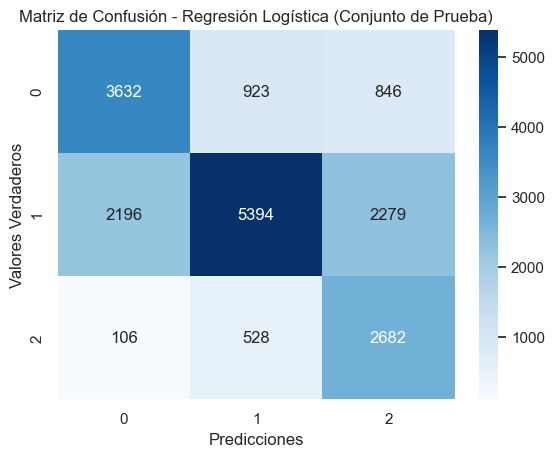

In [44]:

# class_weight='balanced' para ajustar los pesos dando más importancia las clases con frecuencias más bajas --> útil para lidiar con clases desbalanceadas como es el caso
# solver='lbfgs' es un algoritmo de optimización que aproxima el método de Broyden-Fletcher-Goldfarb-Shanno (BFGS),
# utilizado para encontrar los parámetros que minimizan la función de coste.
# max_iter=1000 define el número máximo de iteraciones que el solucionador ejecutará,
# lo que es útil para asegurar que el algoritmo tenga suficientes iteraciones para converger a una solución.

# Inicialización del modelo
log_reg = LogisticRegression(
    random_state=42,
    class_weight='balanced',
    solver='lbfgs',
    max_iter=3000
)

cv_scores = cross_val_score(log_reg, X_train_scaled, y_train, cv=5, scoring='accuracy')


log_reg.fit(X_train_scaled, y_train)

y_train_pred = log_reg.predict(X_train_scaled)

y_test_pred = log_reg.predict(X_test_scaled)

accuracy_train = accuracy_score(y_train, y_train_pred)

accuracy_test = accuracy_score(y_test, y_test_pred)


print(f'CV Accuracy Scores: {cv_scores}')
print(f'CV Accuracy Mean: {np.mean(cv_scores)} ± {np.std(cv_scores)}')
print(f'Accuracy en el conjunto de entrenamiento: {accuracy_train}')
print(f'Accuracy en el conjunto de prueba: {accuracy_test}\n')
print("Reporte de clasificación (conjunto de prueba):\n", classification_report(y_test, y_test_pred))
conf_matrix_log_reg = confusion_matrix(y_test, y_test_pred)
sns.heatmap(conf_matrix_log_reg, annot=True, fmt='g', cmap='Blues')
plt.xlabel('Predicciones')
plt.ylabel('Valores Verdaderos')
plt.title('Matriz de Confusión - Regresión Logística (Conjunto de Prueba)')
plt.show()



Métricas muy bajas por lo que no parece interesante estudiarlas a fondo, aunque no hay overfitting

Al menos se puede sacar la conclusión de que no parecen existir unas relaciones lineales claras.

### **6.3 Naive Bayes**

Fitting 5 folds for each of 100 candidates, totalling 500 fits

Mejores hiperparámetros: {'var_smoothing': 1.0}
Mejor puntaje de exactitud: 0.6028058857778522

Accuracy en el conjunto de entrenamiento: 0.6028058753900786
Accuracy en el conjunto de prueba: 0.6000753255138276

Reporte de clasificación (Conjunto de prueba):
               precision    recall  f1-score   support

           0       0.62      0.67      0.64      5401
           1       0.79      0.49      0.60      9869
           2       0.42      0.83      0.55      3316

    accuracy                           0.60     18586
   macro avg       0.61      0.66      0.60     18586
weighted avg       0.67      0.60      0.60     18586



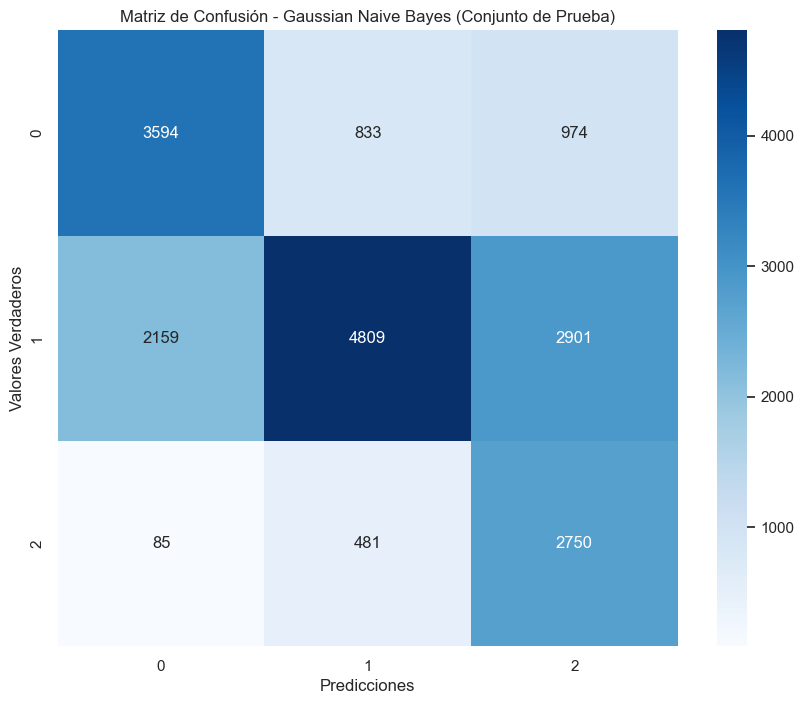

In [45]:

gnb = GaussianNB()

param_grid = {
    'var_smoothing': np.logspace(0, -9, num=100)
}

# GridSearchCV con cross validation de 5 folsd
grid_search = GridSearchCV(estimator=gnb, param_grid=param_grid, cv=5, n_jobs=-1, verbose=1, scoring='accuracy')


grid_search.fit(X_train_scaled, y_train)

print(f'\nMejores hiperparámetros: {grid_search.best_params_}')
print(f'Mejor puntaje de exactitud: {grid_search.best_score_}')

gnb_best = grid_search.best_estimator_
y_train_pred = cross_val_predict(gnb_best, X_train_scaled, y_train, cv=5)
accuracy_train = accuracy_score(y_train, y_train_pred)

y_test_pred = gnb_best.predict(X_test_scaled)
accuracy_test = accuracy_score(y_test, y_test_pred)


print("\nAccuracy en el conjunto de entrenamiento:", accuracy_train)
print("Accuracy en el conjunto de prueba:", accuracy_test)

print("\nReporte de clasificación (Conjunto de test):\n", classification_report(y_test, y_test_pred))

conf_matrix_gnb = confusion_matrix(y_test, y_test_pred)
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix_gnb, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicciones')
plt.ylabel('Valores Verdaderos')
plt.title('Matriz de Confusión - Gaussian Naive Bayes (Conjunto de Prueba)')
plt.show()

Métricas muy bajas por lo que no parece interesante estudiarlas a fondo. Las notas son más bajas que en el modelo de regresión logistica aunque no hay overfitting

Tal vez las variables no sean del todo independientes.

### **6.3 XGBoostClassifier**

n_iterations: 12
n_required_iterations: 13
n_possible_iterations: 12
min_resources_: 30
max_resources_: 74344
aggressive_elimination: False
factor: 2
----------
iter: 0
n_candidates: 6561
n_resources: 30
Fitting 5 folds for each of 6561 candidates, totalling 32805 fits


----------
iter: 1
n_candidates: 3281
n_resources: 60
Fitting 5 folds for each of 3281 candidates, totalling 16405 fits
----------
iter: 2
n_candidates: 1641
n_resources: 120
Fitting 5 folds for each of 1641 candidates, totalling 8205 fits
----------
iter: 3
n_candidates: 821
n_resources: 240
Fitting 5 folds for each of 821 candidates, totalling 4105 fits
----------
iter: 4
n_candidates: 411
n_resources: 480
Fitting 5 folds for each of 411 candidates, totalling 2055 fits
----------
iter: 5
n_candidates: 206
n_resources: 960
Fitting 5 folds for each of 206 candidates, totalling 1030 fits
----------
iter: 6
n_candidates: 103
n_resources: 1920
Fitting 5 folds for each of 103 candidates, totalling 515 fits
----------
iter: 7
n_candidates: 52
n_resources: 3840
Fitting 5 folds for each of 52 candidates, totalling 260 fits
----------
iter: 8
n_candidates: 26
n_resources: 7680
Fitting 5 folds for each of 26 candidates, totalling 130 fits


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


----------
iter: 9
n_candidates: 13
n_resources: 15360
Fitting 5 folds for each of 13 candidates, totalling 65 fits


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


----------
iter: 10
n_candidates: 7
n_resources: 30720
Fitting 5 folds for each of 7 candidates, totalling 35 fits


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


----------
iter: 11
n_candidates: 4
n_resources: 61440
Fitting 5 folds for each of 4 candidates, totalling 20 fits


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(



Mejores hiperparámetros: {'colsample_bytree': 0.5, 'gamma': 0.5, 'learning_rate': 0.01, 'max_depth': 10, 'n_estimators': 200, 'reg_alpha': 0, 'reg_lambda': 1, 'subsample': 1}
Mejor puntaje de exactitud: 0.7395627720312458

Reporte de clasificación:
               precision    recall  f1-score   support

           0       0.77      0.70      0.74      5401
           1       0.76      0.80      0.78      9869
           2       0.65      0.66      0.65      3316

    accuracy                           0.74     18586
   macro avg       0.73      0.72      0.72     18586
weighted avg       0.75      0.74      0.74     18586



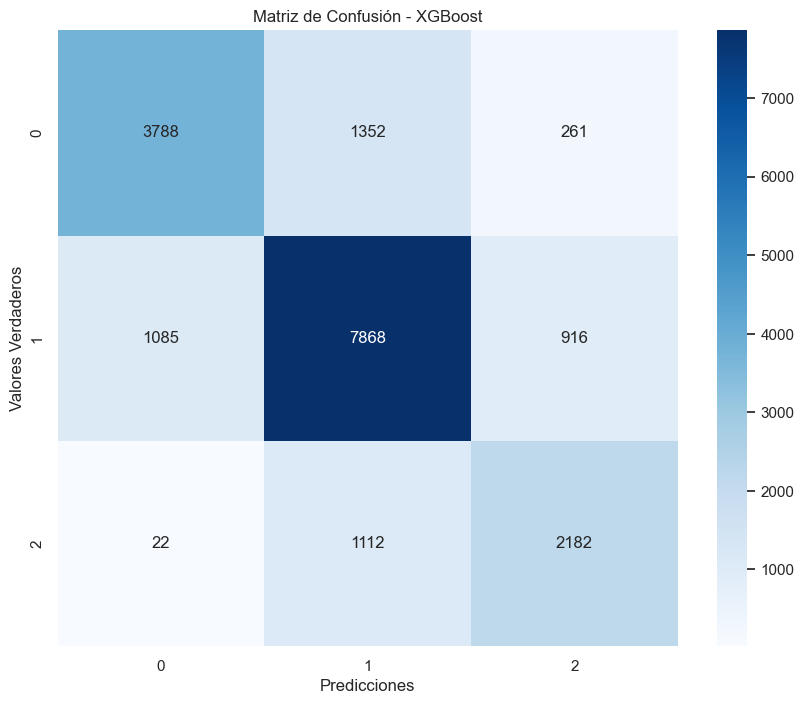

In [40]:

xgbc = XGBClassifier(
    random_state=42,
    use_label_encoder=False,
    eval_metric='mlogloss',  # 'mlogloss' para clasificación multiclase
)


xgbc_params = {
    'n_estimators': [100, 150, 200],  # Cantidad de árboles a construir
    'max_depth': [6, 8, 10],  # Máxima profundidad de cada árbol
    'gamma': [0, 0.5, 1],  # parámetro de regularización para controlar el sobreajuste
    'reg_alpha': [0, 0.5, 1],  # Coeficiente de regularización L1
    'reg_lambda': [1, 1.5, 2],  # coeficiente de regularización L2
    'subsample': [0.5, 0.75, 1],  # Fracción de muestras para entrenar cada árbol
    'colsample_bytree': [0.5, 0.75, 1],  # Fracción de características para entrenar cada árbol
    'learning_rate': [0.01, 0.1, 0.3]  # Tasa de aprendizaje para ajustar los pesos de las prediccioness
}


xgbc_grid = HalvingGridSearchCV(
    estimator=xgbc,
    param_grid=xgbc_params,
    factor=2,  
    cv=5,
    scoring='accuracy',
    n_jobs=4,
    verbose=1
)


xgbc_search = xgbc_grid.fit(X_train_scaled, y_train)

print(f'\nMejores hiperparámetros: {xgbc_search.best_params_}')
print(f'Mejor puntaje de exactitud: {xgbc_search.best_score_}')

xgbc_best = xgbc_search.best_estimator_
xgbc_best.fit(X_train_scaled, y_train)

y_pred_xgbc = xgbc_best.predict(X_test_scaled)

print("\nReporte de clasificación:\n", classification_report(y_test, y_pred_xgbc))

conf_matrix_xgbc = confusion_matrix(y_test, y_pred_xgbc)
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix_xgbc, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicciones')
plt.ylabel('Valores Verdaderos')
plt.title('Matriz de Confusión - XGBoost')
plt.show()



In [18]:
# el modelo XGBost con los mejores hiperparametros --> en caso de querer ejecutarlo sin tener 
# que incluir la búsqueda de hiperparámetros

# M mejores hiperparámetros encontrados
best_params = {
    'colsample_bytree': 0.5,
    'gamma': 0.5,
    'learning_rate': 0.01,
    'max_depth': 10,
    'n_estimators': 200,
    'reg_alpha': 0,
    'reg_lambda': 1,
    'subsample': 1
}


xgbc_best = XGBClassifier(**best_params, random_state=42, use_label_encoder=False, eval_metric='mlogloss')
xgbc_best.fit(X_train_scaled, y_train)

# Hacer predicciones en el conjunto de entrenamiento y prueba
y_train_pred = xgbc_best.predict(X_train_scaled)
y_test_pred = xgbc_best.predict(X_test_scaled)

# Calcular métricas en el conjunto de entrenamiento y prueba
train_accuracy = accuracy_score(y_train, y_train_pred)
test_accuracy = accuracy_score(y_test, y_test_pred)

# Imprimir las exactitudes
print(f"Accuracy en el conjunto de entrenamiento: {train_accuracy}")
print(f"Accuracy en el conjunto de prueba: {test_accuracy}")

# Reporte de clasificación
print("\nReporte de clasificación para el conjunto de prueba:\n", classification_report(y_test, y_test_pred))

# Matriz de confusión para el conjunto de prueba --> descomentar en caso de querer sacar la matriz de confusión
#conf_matrix_xgbc = confusion_matrix(y_test, y_test_pred)
#plt.figure(figsize=(10, 8))
#sns.heatmap(conf_matrix_xgbc, annot=True, fmt='d', cmap='Blues')
#plt.xlabel('Predicciones')
#plt.ylabel('Valores Verdaderos')
#plt.title('Matriz de Confusión - XGBoost')
#plt.show()


Accuracy en el conjunto de entrenamiento: 0.8002797804799311
Accuracy en el conjunto de prueba: 0.7445389002474981

Reporte de clasificación para el conjunto de prueba:
               precision    recall  f1-score   support

           0       0.77      0.70      0.74      5401
           1       0.76      0.80      0.78      9869
           2       0.65      0.66      0.65      3316

    accuracy                           0.74     18586
   macro avg       0.73      0.72      0.72     18586
weighted avg       0.75      0.74      0.74     18586



### **6.4 Gradient Boosting Classifier**

Fitting 5 folds for each of 10 candidates, totalling 50 fits


Mejores hiperparámetros: {'subsample': 1.0, 'n_estimators': 200, 'max_depth': 7, 'learning_rate': 0.1}
Mejor puntuación de exactitud: 0.7605858865388703

Reporte de clasificación:
               precision    recall  f1-score   support

           0       0.77      0.74      0.75      5401
           1       0.78      0.80      0.79      9869
           2       0.70      0.69      0.70      3316

    accuracy                           0.76     18586
   macro avg       0.75      0.74      0.75     18586
weighted avg       0.76      0.76      0.76     18586



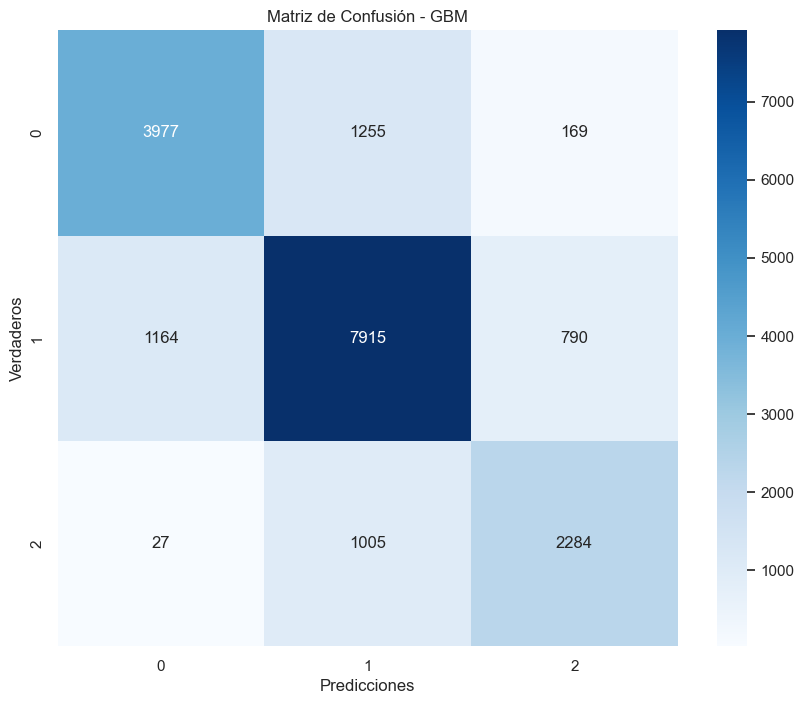

In [43]:

gbm = GradientBoostingClassifier(random_state=42)


param_dist = {
    'n_estimators': [100, 150, 200],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.1],
    'subsample': [0.8, 1.0]  # Fracción de muestras para entrenar cada árbol
}


random_search = RandomizedSearchCV(gbm, param_distributions=param_dist, n_iter=10, cv=5, verbose=1, n_jobs=4, random_state=42)


random_search.fit(X_train_scaled, y_train)

print(f'Mejores hiperparámetros: {random_search.best_params_}')
print(f'Mejor puntuación de exactitud: {random_search.best_score_}')

y_pred = random_search.best_estimator_.predict(X_test_scaled)
print("\nReporte de clasificación:\n", classification_report(y_test, y_pred))


conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicciones')
plt.ylabel('Verdaderos')
plt.title('Matriz de Confusión - GBM')
plt.show()


### **6.5 Random Forest Classifier**

Primero pruebo con los datos sin escalar. Random Forest en principio no es sensible a las diferentes escalas pero
igualmente quiero comprobar si existen diferencias en el resultado del modelo.

En la siguiente celda, realizaré un anaálisis de los mejores hiperparámetros a través de GridSearch, incluyendo un
CrossValidation elevado de 7 folds. Dada la gran cantidad de datos, el modelo puede tardar bastantes horas en realizar todos los fits

In [29]:


rf = RandomForestClassifier(random_state=42, class_weight='balanced')
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [10, 20, 30, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    
    'max_features': ['sqrt', 'log2', None]  
}

# un cv alto, puede llevar aumentar los tiempo considerablemente teniendo en cuenta el gran número de datos
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=7, n_jobs=4, verbose=1, scoring='accuracy')


grid_search.fit(X_train, y_train)


best_rf = grid_search.best_estimator_
best_params = grid_search.best_params_
print("Mejores hiperparámetros:", best_params)


cv_accuracy = cross_val_score(best_rf, X_train, y_train, cv=5, scoring='accuracy')
print(f'CV Accuracy: {cv_accuracy.mean()} ± {cv_accuracy.std()}')

# predict a test
y_pred = best_rf.predict(X_test)
accuracy_test = accuracy_score(y_test, y_pred)
print(f'Test Accuracy: {accuracy_test}')


Fitting 7 folds for each of 324 candidates, totalling 2268 fits


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Mejores hiperparámetros: {'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 300}
CV Accuracy: 0.7838561143609982 ± 0.0029428440277224654
Test Accuracy: 0.7888195415904444


              precision    recall  f1-score   support

           0       0.78      0.81      0.79      5401
           1       0.82      0.79      0.80      9869
           2       0.72      0.75      0.73      3316

    accuracy                           0.79     18586
   macro avg       0.77      0.78      0.78     18586
weighted avg       0.79      0.79      0.79     18586



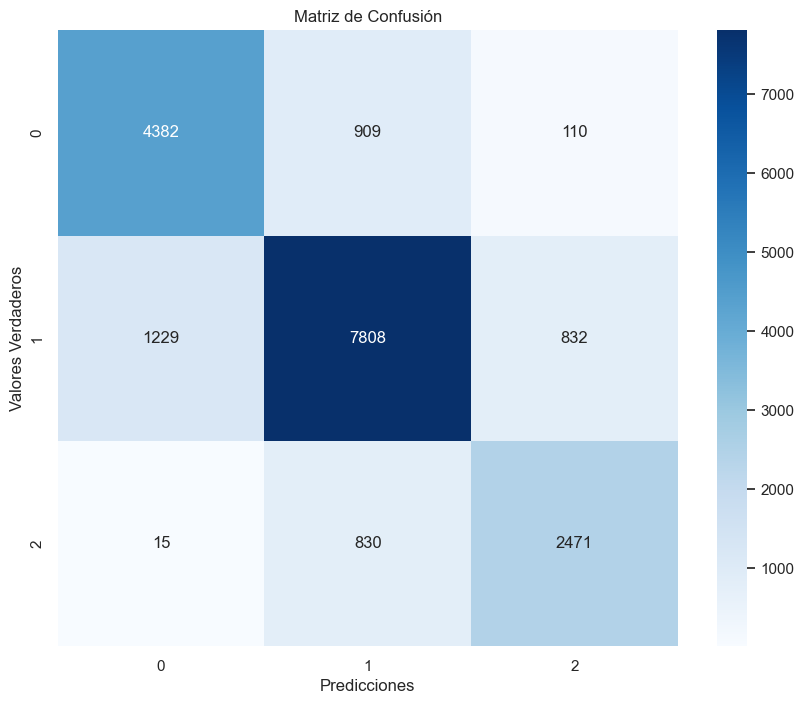

In [30]:
# Métricas principales
print(classification_report(y_test, y_pred))

# Matriz de confusión
conf_matrix = confusion_matrix(y_test, y_pred)

# Mapa de calor
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Matriz de Confusión')
plt.xlabel('Predicciones')
plt.ylabel('Valores Verdaderos')
plt.show()



#### Conclusiones

El modelo muestra un rendimiento sólido con una **exactitud general del 79%**. Aunque maneja bien las clases 'Poor' y 'Standard', muestra áreas de mejora en la clasificación de instancias 'Good'. Las posibles acciones para mejorar incluyen ajustes de hiperparámetros, técnicas de balance de clases y experimentación con diferentes algoritmos.  

Dado que la precisión es mucho mayor que el resto de modelos, la estrategia va a consistir en realizar diferentes pruebas a través de este mismo modelo.    
Por un lado se va a anlizar si existe overfitting y en ese caso tratar de reducirlo todo lo posible, por otro se tratará de mejorar la precisión genérica y por último se estudiarán las métricas más a fondo para entender qué tal se comportan las diferentes clases


### **6.5 Random Forest Classifier V2**

En esta versión, se visualiza el modelo de RandomForestClassifier entrenado con los mejores hiperparámetros obtenidos a partir del GridSearch.
La única diferencia es que en este caso se han utilizado los datos escalados a partir del StandardScaler

Train Accuracy (Optimized): 0.9860109760034435
Test Accuracy (Optimized): 0.7881200903906166
              precision    recall  f1-score   support

           0       0.78      0.81      0.79      5401
           1       0.82      0.79      0.80      9869
           2       0.72      0.74      0.73      3316

    accuracy                           0.79     18586
   macro avg       0.77      0.78      0.78     18586
weighted avg       0.79      0.79      0.79     18586



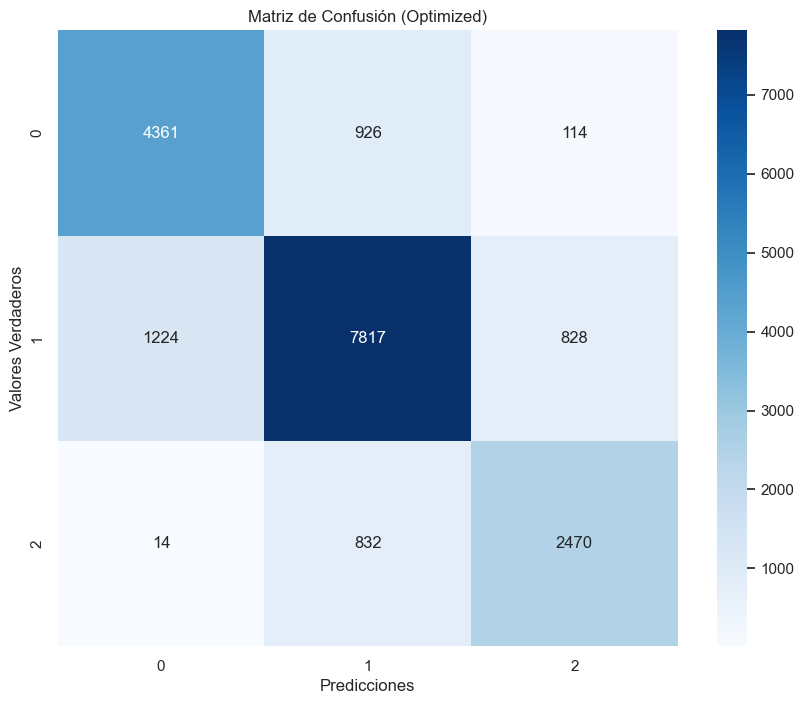

In [74]:

# Hiperparámetros obtenidos del GridSearch previo
best_params = {
    'max_depth': None,
    'max_features': 'sqrt',
    'min_samples_leaf': 1,
    'min_samples_split': 5,
    'n_estimators': 300
}


rf_optimized_uno = RandomForestClassifier(
    random_state=42, 
    class_weight='balanced', 
    **best_params
)

# esta vez con los datos escalados
rf_optimized_uno.fit(X_train_scaled, y_train)


y_pred_train_optimized = rf_optimized_uno.predict(X_train_scaled)
y_pred_optimized = rf_optimized_uno.predict(X_test_scaled)


accuracy_train_optimized = accuracy_score(y_train, y_pred_train_optimized)
accuracy_test_optimized = accuracy_score(y_test, y_pred_optimized)
print(f'Train Accuracy (Datos escalados): {accuracy_train_optimized}')
print(f'Test Accuracy (Datos escalados): {accuracy_test_optimized}')


print(classification_report(y_test, y_pred_optimized))

conf_matrix_optimized = confusion_matrix(y_test, y_pred_optimized)

plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix_optimized, annot=True, fmt='d', cmap='Blues')
plt.title('Matriz de Confusión (Optimized)')
plt.xlabel('Predicciones')
plt.ylabel('Valores Verdaderos')
plt.show()


#### **Informe de Evaluación del Modelo - Comparación de Rendimiento**

El siguiente informe compara el rendimiento del modelo de clasificación de bosque aleatorio antes y después de la optimización y escalado de datos.

##### Matriz de Confusión

| Clase        | Correctas (Antes) | Correctas (Después) | Incorrectas (Antes) | Incorrectas (Después) |
|--------------|-------------------|---------------------|---------------------|-----------------------|
| Poor (0)     | 4382              | 4361                | 1019                | 926                   |
| Standard (1) | 7808              | 7817                | 2061                | 832                   |
| Good (2)     | 2471              | 2470                | 845                 | 830                   |


#### Conclusiones

El rendimiento general del modelo permanece consistente antes y después de la optimización y el escalado de datos. Las diferencias en precisión y recall para cada clase son mínimas, lo que indica que los cambios realizados no tuvieron un impacto demasiado importante en el rendimiento del modelo para este conjunto de datos.  
El modelo muestra un equilibrio razonable entre precisión y recall en todas las clases, lo que es positivo en términos de equilibrio en el rendimiento en la clasificación multiclase.

Esto sugiere que el modelo ya estaba realizando cerca de su capacidad óptima con los hiperparámetros iniciales y que el escalado no tuvo un gran impacto en este caso específico.


**Muestra una alta precisión de entrenamiento (~98.6%) pero tienen una brecha significativa respecto a la precisión de prueba (~78.8%), indicando un sobreajuste considerable.**

### **6.5 Random Forest Classifier V3**

Aunque la precisión del modelo v2 es alta en los resultados de test, sufre de un alto overffiting, siendo muy notable la diferencia de resultados entre train y test.  
La siguiente versión del modelo tratará de centrarse en reducir al máximo el overffiting, para ello se aplicarán los mejores parámetros encontrados en este sentido,  
con el objetivo de que el modelo sea capaz de generalizar mejor 

In [55]:
best_params_adjusted = {
    'max_depth': 10,  # Limitar la profundidad del árbol
    'max_features': 'sqrt',
    'min_samples_leaf': 4,  # Aumentar el número mínimo de muestras por hoja
    'min_samples_split': 10,  # Aumentar el número mínimo de muestras para dividir un nodo
    'n_estimators': 100  # Reducir el número de árboles
}


rf_optimized_dos = RandomForestClassifier(
    random_state=42, 
    class_weight='balanced', 
    **best_params_adjusted
)
rf_optimized_dos.fit(X_train_scaled, y_train)


y_pred_train_optimized_dos = rf_optimized_dos.predict(X_train_scaled)
y_pred_optimized_dos = rf_optimized_dos.predict(X_test_scaled)

accuracy_train_optimized_dos = accuracy_score(y_train, y_pred_train_optimized_dos)
accuracy_test_optimized_dos = accuracy_score(y_test, y_pred_optimized_dos)

print(f'Train Accuracy (Altamente regularizado): {accuracy_train_optimized_dos}')
print(f'Test Accuracy (Altamente regularizado): {accuracy_test_optimized_dos}')


Train Accuracy (Optimized Adjusted): 0.6804584095555795
Test Accuracy (Optimized Adjusted): 0.6716883675885075


**Tiene la menor diferencia entre las precisiones de entrenamiento y prueba, lo que sugiere un control muy bueno del sobreajuste.  
 Sin embargo, la precisión tanto en entrenamiento como en prueba es relativamente baja (68.0% y 67.1%, respectivamente), lo que indica un modelo demasiado regularizado.**

### **6.5 Random Forest Classifier V4**

In [76]:

rfc = RandomForestClassifier(random_state=42, class_weight='balanced')

rfc_params = {
  "max_depth": [None, 10, 15],
  "max_leaf_nodes": [None, 10, 15],  # Añadir None para explorar árboles sin restricción de nodos hoja
  "min_samples_leaf": [3, 4, 5],
  "min_samples_split": [2, 4, 6],
  "n_estimators": [100, 150, 200]
}

rfc_grid = HalvingGridSearchCV(
    estimator=rfc,
    param_grid=rfc_params,
    factor=2,  #  un factor menor explora más candidatos --> reducirlo mucho lo igualaria prácticmanete al gridsearch
    cv=5,
    scoring='accuracy',
    n_jobs=3,
    verbose=1
)


rfc_search = rfc_grid.fit(X_train_scaled, y_train)  

rfc_best = rfc_grid.best_estimator_


y_pred_train = rfc_best.predict(X_train_scaled)
y_pred_test = rfc_best.predict(X_test_scaled)

train_accuracy = accuracy_score(y_train, y_pred_train)
test_accuracy = accuracy_score(y_test, y_pred_test)
train_f1 = f1_score(y_train, y_pred_train, average='weighted')
test_f1 = f1_score(y_test, y_pred_test, average='weighted')

print(f'Train Accuracy: {train_accuracy}')
print(f'Test Accuracy: {test_accuracy}')
print(f'Train F1-Score: {train_f1}')
print(f'Test F1-Score: {test_f1}')


n_iterations: 8
n_required_iterations: 8
n_possible_iterations: 8
min_resources_: 580
max_resources_: 74344
aggressive_elimination: False
factor: 2
----------
iter: 0
n_candidates: 243
n_resources: 580
Fitting 5 folds for each of 243 candidates, totalling 1215 fits


----------
iter: 1
n_candidates: 122
n_resources: 1160
Fitting 5 folds for each of 122 candidates, totalling 610 fits
----------
iter: 2
n_candidates: 61
n_resources: 2320
Fitting 5 folds for each of 61 candidates, totalling 305 fits
----------
iter: 3
n_candidates: 31
n_resources: 4640
Fitting 5 folds for each of 31 candidates, totalling 155 fits
----------
iter: 4
n_candidates: 16
n_resources: 9280
Fitting 5 folds for each of 16 candidates, totalling 80 fits
----------
iter: 5
n_candidates: 8
n_resources: 18560
Fitting 5 folds for each of 8 candidates, totalling 40 fits
----------
iter: 6
n_candidates: 4
n_resources: 37120
Fitting 5 folds for each of 4 candidates, totalling 20 fits
----------
iter: 7
n_candidates: 2
n_resources: 74240
Fitting 5 folds for each of 2 candidates, totalling 10 fits
Train Accuracy: 0.8893387495964704
Test Accuracy: 0.7654686323038846
Train F1-Score: 0.8895913729606416
Test F1-Score: 0.7676678622973984


**Ofrece un equilibrio razonable con una precisión de entrenamiento del ~88.9% y una precisión de prueba del ~76.5%.  
 Aunque la brecha es notable, este modelo parece equilibrar mejor el rendimiento con el control del sobreajuste en comparación con los modelos anteriores**

### **6.5 Random Forest Classifier V5**

Se va a realizar un nuevo test enfocado en incluir técnicas que aborden el problema de el dessbalanceo de clases con el objetivo de mejorar las métricas,  
especilamente con las clases minoritarias que tienen una relevancia importante en este contexto.

En cuanto al umbral de los hiperparámetros incluidos para realizar las pruebas, se van a seleccionar a través de las múltiples pruebas anteriores. Las experiencias pasadas indican que  
se debe de tener cuidado con utilizar ajustes que creen un modelo demasiado complejo, ya que estaba generando un aprendizaje excesivo y perjuducial de los datos de entrenamiento  
provacando que el modelo tuviera problemas para generalizar y predecir correctamente sobre datos nuevos. (La validación cruzada no ha sido suficiente para evitarlo).

- **Balanceo de Clases con SMOTE:** Aplicar técnicas de sobremuestreo para balancear las clases puede ayudar a mejorar la capacidad del modelo para aprender de las clases minoritarias.  
- **Uso de RandomOverSampler:** Similar a SMOTE, pero selecciona muestras al azar con reemplazo de la clase minoritaria para balancear el conjunto de datos.  
- **Optimización con RandomizedSearchCV:** Explorar un espacio de hiperparámetros más amplio de manera aleatoria puede ayudar a encontrar una combinación óptima que mejore el rendimiento del modelo.  
- **Evaluación con Validación Cruzada Estratificada (StratifiedKFold):** Asegura que cada pliegue de la validación cruzada mantenga la proporción de clases, lo cual es crucial para conjuntos de datos desequilibrados.

El objetivo principal es que el modelo tenga la oportunidad de conocer todas las clases por igual para analizar sus características y cuando tenga que hacer predicts sobre nuevos datos sea capaz de 
diferenciar las clases mejor

In [83]:

# Pipeline con SMOTE y RandomForestClassifier (sin class_weight='balanced')
pipeline = IMBPipeline([
    ('smote', SMOTE(k_neighbors=5, random_state=42)),
    ('rfc', RandomForestClassifier(random_state=42))  # Quitamos class_weight='balanced' para tratar de evitar el overfitting
])


rfc_params = {
    'rfc__max_depth': [None, 15, 20],  # Exploramos con y sin límite
    'rfc__max_leaf_nodes': [None, 20, 40],  # Ajuste moderado
    'rfc__min_samples_leaf': [2, 4],  # Incrementamos el mínimo de muestras por hoja
    'rfc__min_samples_split': [6, 8],  # Incrementamos el mínimo para dividir un nodo
    'rfc__n_estimators': [100, 150]  # Reducimos el número de árboles
}

# RandomizedSearchCV con validación cruzada estratificada
cv_strategy = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
rfc_search = RandomizedSearchCV(
    pipeline,
    param_distributions=rfc_params,
    n_iter=50,  # Reducimos las iteraciones para enfocarnos en estos ajustes específicos
    cv=cv_strategy,
    scoring='accuracy',
    n_jobs=4,
    verbose=1
)


rfc_search.fit(X_train_scaled, y_train)


print("Mejores hiperparámetros:", rfc_search.best_params_)
print(f"Mejor puntuación: {rfc_search.best_score_}")


best_model = rfc_search.best_estimator_
y_pred_train = best_model.predict(X_train_scaled)
y_pred_test = best_model.predict(X_test_scaled)
print(f"Train Accuracy: {accuracy_score(y_train, y_pred_train)}")
print(f"Test Accuracy: {accuracy_score(y_test, y_pred_test)}")
print(f"Train F1-Score: {f1_score(y_train, y_pred_train, average='macro')}")
print(f"Test F1-Score: {f1_score(y_test, y_pred_test, average='macro')}")


Fitting 5 folds for each of 50 candidates, totalling 250 fits


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Mejores hiperparámetros: {'rfc__n_estimators': 150, 'rfc__min_samples_split': 6, 'rfc__min_samples_leaf': 2, 'rfc__max_leaf_nodes': None, 'rfc__max_depth': None}
Mejor puntuación: 0.7723151655748881
Train Accuracy: 0.9575217905950716
Test Accuracy: 0.7782739696545787
Train F1-Score: 0.9569200726317648
Test F1-Score: 0.7671959201378565


### **6.6 Análisis y conclusiones**

### Tabla resumen de métricas
| Modelo | Train Accuracy | Test Accuracy | Train F1-Score        | Test F1-Score        |
|--------|----------------|---------------|-----------------------|----------------------|
| V2     | 0.9860         | 0.7881        | Similar a Train Accuracy | Similar a Test Accuracy |
| V3     | 0.6804         | 0.6717        | -       | -       |
| V4     | 0.8893         | 0.7655        | 0.8896                | 0.7677               |
| V5     | 0.9575         | 0.7783        | 0.9569                | 0.7672               |



### Diferencias Principales y Enfoques:

### V1 y V2:
- **Estrategia Común**: Ambos utilizan el mismo conjunto de hiperparámetros y `class_weight='balanced'`.
- **Diferencia**: V2 emplea datos escalados, crucial para mantener la consistencia de las magnitudes entre las características.  
- **Impacto del Escalado**: V2 demuestra cómo el escalado de datos puede influir positivamente en el rendimiento del modelo, mejorando ligeramente la precisión de prueba mientras conserva una alta precisión de entrenamiento. (aunque en RandomForest no afecte tanto)

### V3:
- **Estrategia de Regularización**: Se enfoca en reducir el sobreajuste ajustando parámetros como `max_depth`, `min_samples_leaf`, `min_samples_split`, y reduciendo `n_estimators`.
- **Reducción overfitting y reducción de precisión**: Logra una significativa reducción del sobreajuste a costa de disminuir la precisión tanto en entrenamiento como en prueba, evidenciando el compromiso entre complejidad del modelo y capacidad de generalización.

### V4:
- **Innovación en la Búsqueda**: Introduce `HalvingGridSearchCV` con el objetivo de reducir los tiempos en la búsqueda de los mejores hiperparametros y  con una configuración paramétrica distinta seleccionada a base de 'prueba y error' 
- **Equilibrio vs. Mejora**: A pesar de ser equilibrado en términos de precisión y sobreajuste, la precisión en el conjunto de prueba no mejora significativamente respecto a los modelos anteriores.

### V5:
- **Balanceo y Regularización**: Combina nuevos ajustes como SMOTE o la validación cruzada estratificada para el balanceo de clases con una selección de hiperparámetros enfocada en reducir el sobreajuste (eliminando `class_weight='balanced'`  
 porque tantos ajustes para el desiquilibrio de clases estaba provocando mayor overffiting --> la idea era buscar un equilibrio entre conocer datos de forma proporcional a las clases pero sin aprender el reuido y pudiendo generalizar con nuevos datos).
- **Equilibrio Mejorado**: Ofrece un mejor equilibrio entre precisión de entrenamiento y prueba, aunque todavía hay margen para optimizar la reducción del sobreajuste.


### Modelo seleccionado:
Dados los resultados, no existe una versión claramente superior al resto; en líneas generales tienen métricas parecidas pero con pequeñas diferencias.  
La elección del **V5** como el mejor modelo de esta serie se basa en varios factores clave que lo destacan, a pesar del reconocimiento de que aún existe margen para reducir el sobreajuste.

- Aunque el modelo V5 muestra un sobreajuste, la diferencia entre la precisión de entrenamiento (0.9575) y la precisión de prueba (0.7783) es menor en comparación con otros modelos.
- La precisión en test es buena; con nuevos datos casi alcanza un 80% de precisión
- Tiene margen de mejora, existe un umbral de hiperparámetros que puede ser probado. Lo ideal sería trabajar con Gridsearch para hacer una búsqueda completa, pero tiendo en cuenta que sería necesario un hardware relativamente potente y el tiempo necesario
para hacer diferentes pruebas de larga duración.


### **6.5 Random Forest Classifier V5 --> formato sencillo + grabación del modelo**

Train Accuracy: 0.9575217905950716
Test Accuracy: 0.7782739696545787
Train F1-Score: 0.9569200726317648
Test F1-Score: 0.7671959201378565
Classification Report:
              precision    recall  f1-score   support

           0       0.77      0.81      0.79      5401
           1       0.83      0.76      0.79      9869
           2       0.67      0.77      0.72      3316

    accuracy                           0.78     18586
   macro avg       0.76      0.78      0.77     18586
weighted avg       0.78      0.78      0.78     18586



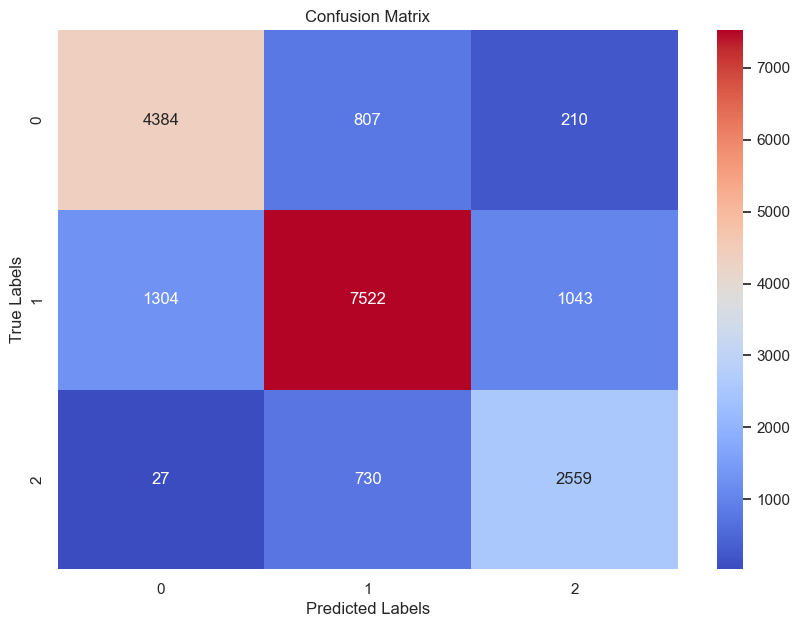

In [38]:
from imblearn.pipeline import Pipeline as IMBPipeline
# Modleo v5 con los mejores ajustes
# Importante: al utilizar un pipeline, la creación de datos sintéticos se aplica automáticamente durante el proceso de entrenamiento del modelo, 
# pero solo afecta al conjunto de datos dentro del pipeline (genera observaciones sintéticas para equilibrar las clases únicamente dentro del flujo de entrenamiento del modelo)
# por tanto,no modifica el conjunto de datos original
best_model = IMBPipeline([
    ('smote', SMOTE(k_neighbors=5, random_state=42)),
    ('rfc', RandomForestClassifier(
        n_estimators=150,
        min_samples_split=6,
        min_samples_leaf=2,
        max_leaf_nodes=None,
        max_depth=None,
        random_state=42
    ))
])


best_model.fit(X_train_scaled, y_train)


y_pred_train = best_model.predict(X_train_scaled)
y_pred_test = best_model.predict(X_test_scaled)


print(f"Train Accuracy: {accuracy_score(y_train, y_pred_train)}")
print(f"Test Accuracy: {accuracy_score(y_test, y_pred_test)}")
print(f"Train F1-Score: {f1_score(y_train, y_pred_train, average='macro')}")
print(f"Test F1-Score: {f1_score(y_test, y_pred_test, average='macro')}")


print("Classification Report:")
print(classification_report(y_test, y_pred_test))


conf_matrix = confusion_matrix(y_test, y_pred_test)
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='g', cmap='coolwarm', cbar=True)  # Usando 'coolwarm' para el mapa de calor
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()


In [ ]:
{'Poor': 0, 'Standard': 1, 'Good': 2}

## Análisis de la Matriz de Confusión

- **Clase 0 -'Poor'- (True Labels: 0):**
  - **Verdaderos Positivos (VP)**: El modelo predijo correctamente 4384 casos de la clase 0.
  - **Falsos Positivos (FP)**: En 807 ocasiones, el modelo predijo incorrectamente que pertenecían a la clase 1 cuando en realidad eran de la clase 0.
  - **Falsos Negativos (FN)**: Hubo 210 casos en los que el modelo no identificó la clase 0, prediciendo erróneamente la clase 2.

- **Clase 1 -'Standard'- (True Labels: 1):**
  - **Falsos Negativos (FN)**: En 1304 casos, el modelo falló al predecir la clase 1, clasificándolos como clase 0.
  - **Verdaderos Positivos (VP)**: Correctamente identificó 7522 casos como pertenecientes a la clase 1.
  - **Falsos Positivos (FP)**: Predijo erróneamente que 1043 casos de clase 2 pertenecían a la clase 1.

- **Clase 2 -'Good'- (True Labels: 2):**
  - **Falsos Negativos (FN)**: Solo 27 casos de clase 0 fueron erróneamente identificados como clase 2 por el modelo.
  - **Falsos Positivos (FP)**: El modelo predijo incorrectamente que 730 casos de clase 1 eran de clase 2.
  - **Verdaderos Positivos (VP)**: Acertadamente, 2559 casos fueron clasificados como clase 2.

Los **Verdaderos Positivos (VP)** son los casos en los que las predicciones del modelo coinciden con las etiquetas verdaderas. Los **Falsos Positivos (FP)** son aquellos donde el modelo predijo incorrectamente la presencia de una clase, y los **Falsos Negativos (FN)** son donde el modelo no identificó correctamente la presencia de la clase.

### Puntos clave:
- La clase 1 tiene la mayor cantidad de predicciones correctas (VP), lo que indica que el modelo es bastante competente en identificar esta clase.
- Las clases 0 y 2 tienen menos VPs en comparación, lo que sugiere que el modelo tiene más dificultades para identificar estas clases correctamente.
- Los FN para la clase 2 son notoriamente bajos, lo que significa que casi nunca se confunde a las clases 0 o 1 como clase 2.
- La mayoría de los errores del modelo se producen al confundir la clase 0 con la clase 1 y viceversa.

El modelo podría estar sesgado hacia la clase con más ejemplos en el conjunto de entrenamiento, que parece ser la clase 1. La eficacia en la detección de las clases 0 y 2 podría mejorarse potencialmente equilibrando mejor el conjunto de datos o ajustando los parámetros del modelo para reducir los errores de clasificación entre estas clases.


In [40]:
import joblib
# Guardar el modelo
joblib.dump(best_model, 'random_forest_v5.joblib')


['random_forest_v5.joblib']

In [45]:
# voy a guardar los datos antes del split, econoding y demás para en el futuro hacer pruebas en otros notebboks con los datos limpios
train_df.to_csv('./data/clean_data.csv', index=False)
